## Turbulence code for paper 'Observing flow of He II with unsupervised machine learning'

Xin Wen, Mike Fitzsimmons

04.18.2022

This script runs all turbulence data analysis step by step.
All function are stored in turbulence.py. Must import turbulence.py before running the script. 

04.18.2022 
Added peak filters to identy 'birth' clouds from diffused clouds by cut off intensity from intensity histogram. 
The two types pf peaks are then clustered seperately.
Contains unfinished work.

05.10.2022 
Add net velocity vector in correlator function.
Quit diffused clouds/birth clouds idea.

09.06.2022
Fix errors


## Import Libraries

In [1]:
import numpy as np
import numpy.ma as ma
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.colors import LogNorm
import matplotlib.colors as colors
from mpl_toolkits.mplot3d import Axes3D
import sys
import os
import spe2py as spe
import spe_loader as sl
import getopt
import scipy.io as sio
import scipy.optimize as opt
from scipy import ndimage, misc
from datetime import datetime
from datetime import timedelta 
from dateutil import parser
import photutils.detection
import copy
import ipympl
import gc # release memroy
from sklearn.cluster import MeanShift, estimate_bandwidth
from itertools import cycle
# For correlator
import itertools as it
from IPython.display import display, HTML
from scipy.stats import skew
from scipy.stats import kurtosis
import turbulence
import importlib
importlib.reload(turbulence)

%matplotlib inline
# %matplotlib notebook

display(HTML(data="""
<style>
    div#notebook-container    { width: 95%; }
    div#menubar-container     { width: 65%; }
    div#maintoolbar-container { width: 99%; }
</style>
"""))

In [2]:
BackFile = 'input/Background_NORM_3_18_44 20_46_32 796-raw.spe' ####### Enter your background file name here after input/.
InputFile = 'input/NORM_3_18_44_Script113 19_45_16 967-raw.spe' ####### Enter the name of the file you want to exam here after input/.
OutputFile = InputFile[InputFile.find('Script'):InputFile.find('-raw')].replace(" ", "_")
DefaultDir = os.getcwd() + r'/'

SpeNet_stdev = 15 # This is the standard deviation calculated from frames of lasers on neutrons off
nsig = 4

## Get the data


In [3]:
## Read in spe file and remove background Extract SpeNet and timestamps into numpy arrays
# The function returns SpeNet, BackAvg, TimeStampArray, AbsoluteTimeArray
os.chdir(DefaultDir)
importlib.reload(turbulence)
SpeNet, background, BackAvg, TimeStampArray, total_frame_number, xdim, ydim = turbulence.read_spe(BackFile, InputFile)

/Users/mf3/Dropbox (ORNL)/Project Turbulent Flow/Our Papers/SecondPaper/DataRepository/example_for_mike_to_test/input/Background_NORM_3_18_44 20_46_32 796-raw.spe
XML Footer was not loaded prior to calling _get_wavelength or 
XML Footer does not contain Wavelength Mapping information
Successfully loaded 1 file(s) in a SpeFile object
Number of frames in background = 1001
Dimensions of a frame are 256 by 256
/Users/mf3/Dropbox (ORNL)/Project Turbulent Flow/Our Papers/SecondPaper/DataRepository/example_for_mike_to_test/input/NORM_3_18_44_Script113 19_45_16 967-raw.spe
XML Footer was not loaded prior to calling _get_wavelength or 
XML Footer does not contain Wavelength Mapping information
Successfully loaded 1 file(s) in a SpeFile object
Number of frames in raw data = 1001
Dimensions of a frame are 256 by 256
The absolute time of the start of the first frame = 2020-10-22T19:45:16.8914352-04:00
The average intensity of one pixel in one frame of background = 603.3584594726562
The average int

## Display image integrated over all slices

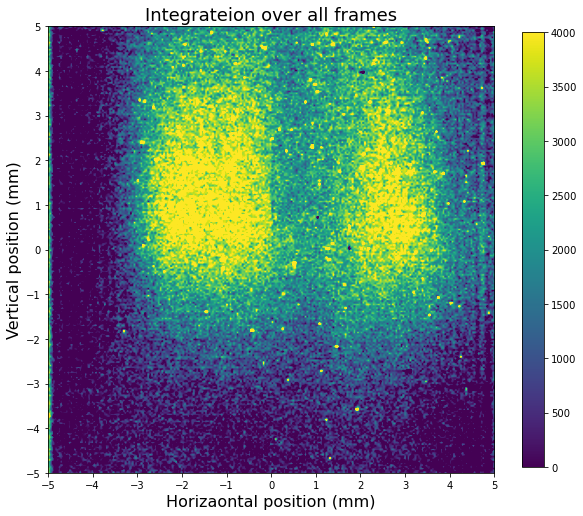

In [4]:
importlib.reload(turbulence)
Vmax = 4000 ###### You can change color bar scale here for best contrast
turbulence.display_frame_integral(SpeNet, beginning_frame = 0, ending_frame = len(SpeNet), Vmax = 4000)

# Fitting the yellow strip

## Apply first mask (Simply exclude data with time outside TMin-TMax)

Beginning frame: 222
Ending frame: 501


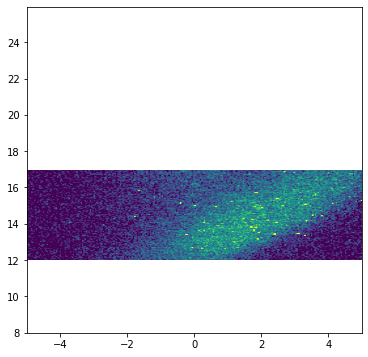

In [5]:
VProjection = np.sum(SpeNet, axis = 2)
TMin = np.min(TimeStampArray[:,0]/1e6)
TMax = np.max(TimeStampArray[:,0]/1e6)
np.savetxt(str(InputFile[-30:-8])+'_VProjection.txt',VProjection)

SignalFit1 = np.empty((total_frame_number, xdim))
# Set data above TStar to be equal to data a TStar
TStarLo, TStarHi = 12., 17. ##### You need to manually select the TStarLo and TStarHi. The time range to fit.
TStarSdxLo, TStarSdxHi = int(max(np.argwhere(TimeStampArray[:,0]*1.e-6 <= TStarLo))), int(min(np.argwhere(TimeStampArray[:,0]*1.e-6 >= TStarHi)))
print('Beginning frame: %d\nEnding frame: %d'%(TStarSdxLo, TStarSdxHi))

n = VProjection.shape[0] # number time bins
m = VProjection.shape[1] # number position bins
mask1 = np.empty([n,m],dtype=bool)
mask1.fill(False)
mask1[TStarSdxLo:TStarSdxHi,:].fill(True)

## Show the masked data
VProjectionMasked1 = np.ma.array(VProjection, mask=~mask1)
plt.figure(figsize = (6,6))
plt.imshow(np.flip(VProjectionMasked1,axis=1), origin='lower', aspect='auto', extent=([-5,5,TMin,TMax]), interpolation='bilinear', cmap=cm.viridis, norm=colors.Normalize(vmin=0, vmax=np.max(VProjection)/14))
plt.show()

## Fit a surface to the v vs t data.

Identify a mask==True region to fit a surface to the data and fit the function to the data.

In [6]:
fit_results = open('Velocity_fit_results.txt','a')
TMin = np.min(TimeStampArray[:,0]/1e6) # 1st frame
TMax = np.max(TimeStampArray[:,0]/1e6) # 1st frame
t,v = np.where(mask1[:,:] == True) #  i,j for True
xdata = np.vstack((t.ravel(),v.ravel())) # converts 2 indices to 1D array
t0,v0 = np.zeros(n*m, dtype=np.int32),np.zeros(n*m, dtype=np.int32) #x0,y0 have indices for entire background even under ROI
k = 0
for i in range(n):
    for j in range(m):
        t0[k] = i
        v0[k] = j
        k = k + 1
xdata0 = np.vstack((t0.ravel(),v0.ravel())) # converts 2 indices to 1D array
# We fit only data within Mask==True between TStarLo and TStarHi
Feed1 = VProjection[t,v]
SigmaFeed1 = np.sqrt(np.abs(Feed1))

InitialGuesses = [-2300., -30., 0.1,-0.46,196.,30.,1000.,2.,0.1, 1.,0.1]  # 967
popt = InitialGuesses

SignalFit1[t0,v0] = turbulence.FlushCalculation(xdata0, *popt)  # this is the fitted flush
Residuals1 = np.abs(VProjection - SignalFit1)

ChiSqr = np.sum(Residuals1**2)/(len(t)*len(v))
print('Initial Chisqr = %.2f'%ChiSqr)
fit_results.write('\n'+str(InputFile[19:-8])+':')
fit_results.write('\nInitial Chisqr = %5.2f'%ChiSqr)

# Now fit 
popt, pcov = opt.curve_fit(turbulence.FlushCalculation, xdata, Feed1.ravel(), p0=InitialGuesses, maxfev = 100000,
                          bounds = ([-np.inf,-np.inf,-np.inf,-0.46,195,-np.inf,-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,-0.436,398,np.inf,np.inf,np.inf,np.inf,np.inf,np.inf]))

SignalFit1[t0,v0] = turbulence.FlushCalculation(xdata0, *popt)  # this is the fitted flush
Residuals1 = np.abs(VProjection - SignalFit1)

ChiSqr = np.sum(Residuals1**2)/(len(t)*len(v))
print('Final Chisqr = %.2f'%ChiSqr)

for i in range(len(InitialGuesses)):
#     print('%.3e\t%.3e'%(InitialGuesses[i],popt[i]))
    print('%.3f\t\t%.3f'%(InitialGuesses[i],popt[i]))

print('Equation of axis in vertical pixel vs. time bin is: v(t) = %.3f t(bin) + %.2f'%(popt[3],popt[4]))
mP = -popt[3] * n / (TMax-TMin) / m * 10. # converts slope to mm per second
mP_errorbar = - (pcov[3,3]**0.5 *2) * n / (TMax-TMin) / m * 10.
bP = (m-1 - popt[4]) / m * 10. - 5. - mP * TMin # 256 pixels is 10mm but pixel 128 is position 0
print('Equation of axis in vertical position (mm) vs. time (s) is: v(t) = %.3f t + %.2f'%(mP,bP))
print('Velocity is %.3f mm/s.'%np.abs(mP))
print('Velocity EorroBar is %.3f.'%np.abs(mP_errorbar))

fit_results.write('\nFinal Chisqr = %5.2f'%ChiSqr)
fit_results.write('\nEquation of axis in vertical pixel vs. time bin is: v(t) = %.3f t(bin) + %.2f'%(popt[3],popt[4]))
fit_results.write('\nEquation of axis in vertical position (mm) vs. time (s) is: v(t) = %.3f t + %.2f'%(mP,bP))
fit_results.write('\nVelocity is %1.3f mm/s'%np.abs(mP))
fit_results.write('\nErrorbar is %.3f mm/s'%np.abs(mP_errorbar))
fit_results.write('\n\n')
fit_results.close()

Initial Chisqr = 115780.87
Final Chisqr = 30.59
-2300.000		-1800.925
-30.000		16.443
0.100		-0.023
-0.460		-0.458
196.000		240.153
30.000		33.844
1000.000		-206.507
2.000		0.360
0.100		0.001
1.000		5.658
0.100		-0.024
Equation of axis in vertical pixel vs. time bin is: v(t) = -0.458 t(bin) + 240.15
Equation of axis in vertical position (mm) vs. time (s) is: v(t) = 0.996 t + -12.37
Velocity is 0.996 mm/s.
Velocity EorroBar is 0.022.


## Calculate the slope and intercept of the new mask boundary lines for re-fitting

In [7]:
# mp = 1.
# bp= -11.5
# popt3 = -(TMax-TMin)*m/10/n*mp
# popt4 = -(5+mp*TMin +bp)*m/10-1+m
# print(popt3, popt4)
mask_distance = 1.5 

# First Fit
mP1 = mP # in mm/s
bP1 = bP
popt3_1 = -(TMax-TMin)*m/10/n*mP1
popt4_1 = -(5+mP1*TMin +bP1)*m/10-1+m

## Black dash line, Upper left of the strip
mP2 = mP # in mm/s
bP2 = bP - mask_distance * np.sqrt(1 + mP**2) # in s
popt3_2 = -(TMax-TMin)*m/10/n*mP2
popt4_2 = -(5+mP2*TMin +bP2)*m/10-1+m

# Yellow dash line, lower right of the strip
mP3 = mP # in mm/s
bP3 = bP + mask_distance * np.sqrt(1 + mP**2)
popt3_3 = -(TMax-TMin)*m/10/n*mP3
popt4_3 = -(5+mP3*TMin +bP3)*m/10-1+m

## Plot the fitted slope onto VProjection and plot the boundaries of the new mask with dashed lines

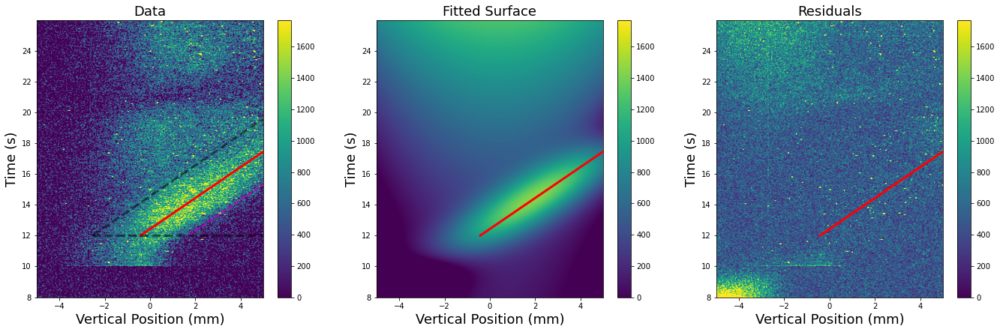

In [8]:
plt.figure(figsize = (23,6.8))
plt.subplot(1,3,1)
plt.xlabel('Vertical Position (mm)', fontsize=18)
plt.ylabel('Time (s)', fontsize=18)
plt.title('Data', fontsize=18)
plt.imshow(np.flip(VProjection,axis=1), origin='lower', aspect='auto', extent=([-5,5,TMin,TMax]), interpolation='bilinear', cmap=cm.viridis, norm=colors.Normalize(vmin=0, vmax=np.max(VProjection)/20))
plt.colorbar()
#AxisX, AxisY = np.array([mP*TStarLo+bP,mP*TStarHi+bP]), np.array([TStarLo,TStarHi])
AxisX, AxisY = np.array([mP1*TStarLo+bP1,5]), np.array([TStarLo,(5-bP1)/mP1]) # Fitted slope
AxisX2, AxisY2 = np.array([mP2*TStarLo+bP2,5]), np.array([TStarLo,(5-bP2)/mP2]) # Parallel to the slope
AxisX3, AxisY3 = np.array([mP3*TStarLo+bP3,5]), np.array([TStarLo,(5-bP3)/mP3]) # Parallel to the slope
AxisX6, AxisY6 = np.array([mP2*TStarLo+bP2,5]), np.array([TStarLo,TStarLo]) # TMin = 12s limit

plt.plot(AxisX,AxisY,'r',linewidth=3)
plt.plot(AxisX2,AxisY2,'k',linestyle = '--',linewidth=3, alpha=0.5) # Parallel to the slope
plt.plot(AxisX3,AxisY3,'m',linestyle = '--',linewidth=2) # Parallel to the slope
plt.plot(AxisX6,AxisY6,'k',linestyle = '--',linewidth=3, alpha=0.5) # TMin = 12s limit, Parallel to x axis

plt.subplot(1,3,2)
plt.xlabel('Vertical Position (mm)', fontsize=18)
plt.ylabel('Time (s)', fontsize=18)
plt.title('Fitted Surface', fontsize=18)
plt.imshow(np.flip(SignalFit1,axis=1), origin='lower', aspect='auto', extent=([-5,5,TMin,TMax]), interpolation='bilinear', cmap=cm.viridis, norm=colors.Normalize(vmin=0, vmax=np.max(VProjection)/20))
plt.colorbar()
plt.plot(AxisX,AxisY,'r',linewidth=3)
plt.savefig(str(InputFile[-30:-8])+'_fit_1stStep.pdf')

plt.subplot(1,3,3)
plt.xlabel('Vertical Position (mm)', fontsize=18)
plt.ylabel('Time (s)', fontsize=18)
plt.title('Residuals', fontsize=18)
plt.imshow(np.flip(Residuals1,axis=1), origin='lower', aspect='auto', extent=([-5,5,TMin,TMax]), interpolation='bilinear', cmap=cm.viridis, norm=colors.Normalize(vmin=0, vmax=np.max(VProjection)/20))
plt.colorbar()
plt.plot(AxisX,AxisY,'r',linewidth=3)

plt.savefig(str(InputFile[-30:-8])+'_fit_1stStep.pdf')

plt.show()

## Apply the new mask with boundaries defined from the last step

(array([  0,   0,   0, ..., 999, 999, 999]), array([  0,   1,   2, ..., 253, 254, 255]))


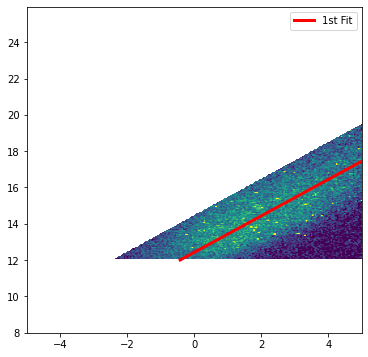

In [9]:
VProjection = np.sum(SpeNet, axis = 2)
SignalFit2 = np.empty((total_frame_number, xdim))
n = VProjection.shape[0] # number time bins
m = VProjection.shape[1] # number position bins

mask2 = np.empty([n,m],dtype=bool)

mask2[TStarSdxLo:TStarSdxHi,:].fill(False) # Set data within Lo and Hi limits to be true

mask2.fill(True)
for VP in range(m):
    for time in range(n):
            
        popt3_2 = -(TMax-TMin)*m/10/n*mP2
        popt4_2 = -(5+mP2*TMin +bP2)*m/10-1+m
        if time > (VP-popt4_2)/popt3_2:
            mask2[time,VP] = False
    
#         popt3_3 = -(TMax-TMin)*m/10/n*mP3
#         popt4_3 = -(5+mP3*TMin +bP3)*m/10-1+m
#         if time < (VP-popt4_3)/popt3_3:
#             mask2[time,VP] = True

        if time*(TMax-TMin)/n+TMin < TStarLo:
            mask2[time,VP] = False
            
#         if time*(TMax-TMin)/n+TMin > TStarHi:
#             mask2[time,VP] = True

#         if VP *10/m - 5 > 0:
#             mask2[time,VP] = True

print(np.where(mask2==False))

## Plot the masked VProjection
VProjectionMasked2 = np.ma.array(VProjection, mask=~mask2)
plt.figure(figsize = (6,6))
plt.imshow(np.flip(VProjectionMasked2,axis=1), origin='lower', aspect='auto', extent=([-5,5,TMin,TMax]), interpolation='bilinear', cmap=cm.viridis, norm=colors.Normalize(vmin=0, vmax=np.max(VProjection)/14))
AxisX1st, AxisY1st = np.array([mP1*TStarLo+bP1,5]), np.array([TStarLo,(5-bP1)/mP1])
plt.plot(AxisX1st,AxisY1st,'r',linewidth=3, label = '1st Fit')
plt.legend()
plt.show()

## 2nd step fitting

In [10]:
fit_results = open('Velocity_fit_results.txt','a')
VProjection = np.sum(SpeNet, axis = 2)
t2,v2 = np.where(mask2[:,:] == True) #  i,j for True

xdata2 = np.vstack((t2.ravel(),v2.ravel())) # converts 2 indices to 1D array
xdata2 = [t2,v2]
t02,v02 = np.zeros(n*m, dtype=np.int32),np.zeros(n*m, dtype=np.int32) #x0,y0 have indices for entire background even under ROI
k = 0
for i in range(n):
    for j in range(m):
        t02[k] = i
        v02[k] = j
        k = k + 1
xdata02 = np.vstack((t02.ravel(),v02.ravel())) # converts 2 indices to 1D array

# We fit only data within Mask==True between TStarLo and TStarHi
Feed2 = VProjection[t2,v2]
SigmaFeed2 = np.sqrt(np.abs(Feed2))

InitialGuesses2 = popt
popt2 = InitialGuesses2

SignalFit2[t02,v02] = turbulence.FlushCalculation(xdata02, *popt2)  # this is the fitted flush
Residuals2 = np.abs(VProjection - SignalFit2)
ChiSqr2 = np.sum(Residuals2**2)/(len(t2)*len(v2))
print('Initial Chisqr = %.2f'%ChiSqr2)
fit_results.write('\n'+str(InputFile[19:-8])+':')
fit_results.write('\nInitial Chisqr = %5.2f'%ChiSqr2)

# Now fit
popt2, pcov2 = opt.curve_fit(turbulence.FlushCalculation, xdata2, VProjection[t2,v2], p0=InitialGuesses2, maxfev = 10000)#,
#                            bounds = ([-np.inf,-np.inf,-np.inf,-0.47,135,-np.inf,-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,-0.24,245,np.inf,np.inf,np.inf,np.inf,np.inf,np.inf]))
SignalFit2[t02,v02] = turbulence.FlushCalculation(xdata02, *popt2)  # this is the fitted flush original

Residuals2 = np.abs(VProjection - SignalFit2)

ChiSqr2 = np.sum(Residuals2**2)/(len(t2)*len(v2))
print('Final Chisqr = %.2f'%ChiSqr2)

for i in range(len(InitialGuesses2)):
    print('%.3f\t\t%.3f'%(InitialGuesses2[i],popt2[i]))

print('Equation of axis in vertical pixel vs. time bin is: v(t) = %.3f t(bin) + %.2f'%(popt2[3],popt2[4]))
mP02 = -popt2[3] * n / (TMax-TMin) / m * 10. # converts slope to mm per second
mP_errorbar2 = - (pcov2[3,3]**0.5 *2) * n / (TMax-TMin) / m * 10.
bP02 = (m-1 - popt2[4]) / m * 10. - 5. - mP02 * TMin # 256 pixels is 10mm but pixel 128 is position 0
print('Equation of axis in vertical position (mm) vs. time (s) is: v(t) = %.3f t + %.2f'%(mP02,bP02))
print('Velocity is %.3f mm/s.'%np.abs(mP02))
print('Velocity EorroBar is %.3f.'%np.abs(mP_errorbar2))

fit_results.write('\nFinal Chisqr = %5.2f'%ChiSqr2)
fit_results.write('\nEquation of axis in vertical pixel vs. time bin is: v(t) = %.3f t(bin) + %.2f'%(popt2[3],popt2[4]))
fit_results.write('\nEquation of axis in vertical position (mm) vs. time (s) is: v(t) = %.3f t + %.2f'%(mP02,bP02))
fit_results.write('\nVelocity is %1.3f mm/s'%np.abs(mP02))
fit_results.write('\nErrorbar is %.3f mm/s'%np.abs(mP_errorbar2))
fit_results.write('\n\n')
fit_results.close()

Initial Chisqr = 95.73
Final Chisqr = 191.16
-1800.925		-859.421
16.443		11.708
-0.023		-0.018
-0.458		-0.468
240.153		240.575
33.844		30.662
-206.507		-364.391
0.360		0.588
0.001		0.002
5.658		5.299
-0.024		-0.020
Equation of axis in vertical pixel vs. time bin is: v(t) = -0.468 t(bin) + 240.58
Equation of axis in vertical position (mm) vs. time (s) is: v(t) = 1.017 t + -12.56
Velocity is 1.017 mm/s.
Velocity EorroBar is 0.041.


## Plot results of the 2nd fitting

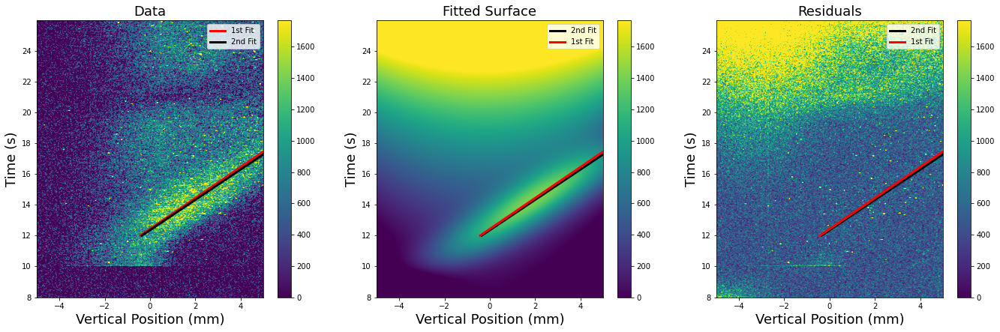

In [11]:
AxisX1st, AxisY1st = np.array([mP1*TStarLo+bP1,5]), np.array([TStarLo,(5-bP1)/mP1])
AxisX2nd, AxisY2nd = np.array([mP02*TStarLo+bP02,5]), np.array([TStarLo,(5-bP02)/mP02])

plt.figure(figsize = (23,6.8))
plt.subplot(1,3,1)
plt.xlabel('Vertical Position (mm)', fontsize=18)
plt.ylabel('Time (s)', fontsize=18)
plt.title('Data', fontsize=18)
plt.imshow(np.flip(VProjection,axis=1), origin='lower', aspect='auto', extent=([-5,5,TMin,TMax]), interpolation='bilinear', cmap=cm.viridis, norm=colors.Normalize(vmin=0, vmax=np.max(VProjection)/20))
plt.colorbar()
plt.plot(AxisX1st,AxisY1st,'r',linewidth=3, label = '1st Fit')
plt.plot(AxisX2nd,AxisY2nd,'k',linewidth=3, label = '2nd Fit')
plt.legend()

plt.subplot(1,3,2)
plt.xlabel('Vertical Position (mm)', fontsize=18)
plt.ylabel('Time (s)', fontsize=18)
plt.title('Fitted Surface', fontsize=18)
plt.imshow(np.flip(SignalFit2,axis=1), origin='lower', aspect='auto', extent=([-5,5,TMin,TMax]), interpolation='bilinear', cmap=cm.viridis, norm=colors.Normalize(vmin=0, vmax=np.max(VProjection)/20))
plt.colorbar()
plt.plot(AxisX2nd,AxisY2nd,'k',linewidth=3, label = '2nd Fit')
plt.plot(AxisX1st,AxisY1st,'r',linewidth=3, label = '1st Fit')
plt.legend()

plt.subplot(1,3,3)
plt.xlabel('Vertical Position (mm)', fontsize=18)
plt.ylabel('Time (s)', fontsize=18)
plt.title('Residuals', fontsize=18)
plt.imshow(np.flip(Residuals2,axis=1), origin='lower', aspect='auto', extent=([-5,5,TMin,TMax]), interpolation='bilinear', cmap=cm.viridis, norm=colors.Normalize(vmin=0, vmax=np.max(VProjection)/20))
plt.colorbar()
plt.plot(AxisX2nd,AxisY2nd,'k',linewidth=3, label = '2nd Fit')
plt.plot(AxisX1st,AxisY1st,'r',linewidth=3, label = '1st Fit')
plt.legend()

plt.savefig(str(InputFile[-30:-8])+'_fit_2ndStep.pdf')
plt.show()

## Plot Figure 2 of paper

<ipython-input-12-65f242e9a57a>:36: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "fontsize" which is no longer supported as of 3.3 and will become an error two minor releases later
  plt.savefig(str(OutputFile)+'Integration along the horizontal direction.pdf', fontsize = 18)


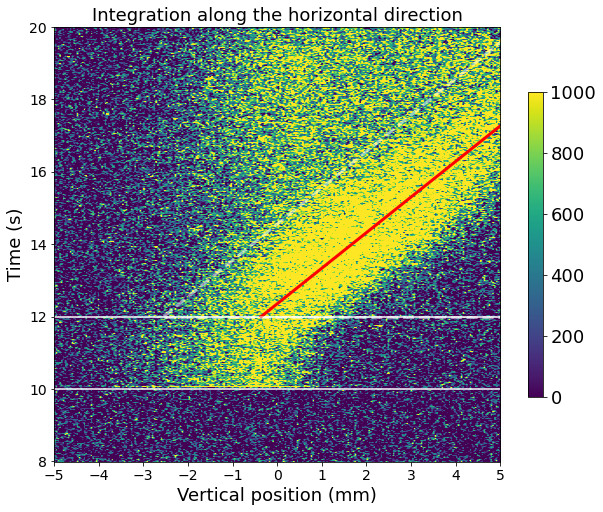

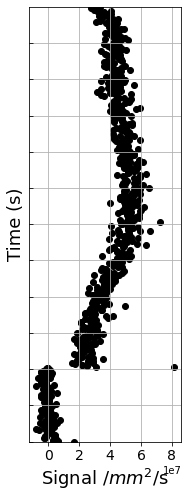

In [12]:
Vmax = 1000 ###### You can change color bar scale here for best contrast
TMin = np.min(TimeStampArray[:,0]/1e6) # 1st frame
TMax = 20 # We only show integral from beginning to 20s here
# TMax = np.max(TimeStampArray[:,0]/1e6)
TMaxFrame = int(min(np.argwhere(TimeStampArray[:,0]/1e6 >= TMax))) # Get the frame number of T = 20s
VProjection = np.sum(SpeNet[0:TMaxFrame], axis = 2) 
AxisX1st, AxisY1st = np.array([mP1*TStarLo+bP1,5]), np.array([TStarLo,(5-bP1)/mP1]) # 1st fit
AxisX2nd, AxisY2nd = np.array([mP02*TStarLo+bP02,5]), np.array([TStarLo,(5-bP02)/mP02]) # 2nd fit
AxisX2, AxisY2 = np.array([mP2*TStarLo+bP2,5]), np.array([TStarLo,(5-bP2)/mP2]) # Parallel to the slope
# AxisX3, AxisY3 = np.array([mP3*TStarLo+bP3,5]), np.array([TStarLo,(5-bP3)/mP3]) # Parallel to the slope
# AxisX4, AxisY4 = np.array([mP4*TStarLo+bP4,5]), np.array([TStarLo,(5-bP4)/mP4]) # Perpendicular to the slope
# AxisX5, AxisY5 = np.array([mP5*TStarLo+bP5,5]), np.array([TStarLo,(5-bP5)/mP5]) # Perpendicular to the slope
AxisX6, AxisY6 = np.array([mP2*TStarLo+bP2,5]), np.array([TStarLo,TStarLo]) # TMin = 12s limit


# Plot Figure 2, left
f = plt.figure(figsize=(10,8))
ax = f.add_subplot()
plt.imshow(np.flip(VProjection,axis = 1), aspect='auto', origin='lower',extent=([-5,5,TMin,TMax]),interpolation='bilinear', cmap=cm.viridis, norm=colors.Normalize(vmin=0, vmax = Vmax))
plt.axhline(y = 10, color = 'w') # This hrizonatl line shows when the laser was turned on at time = 10s
plt.axhline(y = 12, color = 'w') # This hrizonatl line shows when the heater was turned on at time = 12s

plt.plot(AxisX2nd,AxisY2nd,'r',linewidth=3) # 2nd fit line
plt.plot(AxisX2,AxisY2,'w',linestyle = '--',linewidth=3, alpha=0.5) # Boundary 1, Parallel to the slope
# plt.plot(AxisX3,AxisY3,'w',linestyle = '--',linewidth=2) # Parallel to the slope
# plt.plot(AxisX4,AxisY4,'w',linestyle = '--',linewidth=2) # Perpendicular to the slope
# plt.plot(AxisX5,AxisY5,'w',linestyle = '--',linewidth=2) # Perpendicular to the slope
plt.plot(AxisX6,AxisY6,'w',linestyle = '--',linewidth=3, alpha=0.5) # Boundary, TMin = 12s limit, Parallel to x axis
plt.xlabel('Vertical position (mm)', fontsize=18)
plt.ylabel('Time (s)', fontsize=18)
plt.xticks(np.arange(-5, 6, step=1),fontsize = 14)
plt.yticks(np.arange(8, TMax+1, step=2),fontsize = 14)
cbar = plt.colorbar(shrink = 0.7)
cbar.ax.tick_params(labelsize=18) 
plt.title('Integration along the horizontal direction', fontsize = 18)
plt.savefig(str(OutputFile)+'Integration along the horizontal direction.pdf', fontsize = 18)

# Plot Figure 2, right
TimeIntegral = np.sum(np.sum(SpeNet,axis=2),axis=1)
plt.figure(figsize = (6,8))
plt.subplot(1,2,2)
plt.xlabel('Signal /$mm^{2}$/s', fontsize=18)
plt.ylabel('Time (s)', fontsize=18)
# plt.xlim = ((0,255))
plt.ylim(8,TMax)
plt.xticks(np.arange(0, 10e7, step=2e7),fontsize = 14)
plt.yticks(np.arange(8, TMax, step=1), '')
plt.tick_params(axis="y",direction="in", pad=-22)
# plt.grid(True)
plt.scatter(TimeIntegral[0:TMaxFrame]/10**2/3e-5,TimeStampArray[:,0][0:TMaxFrame]*1e-6,c = 'k') # markersize=3,
plt.grid('on')
plt.savefig(str(OutputFile)+'_SignalvsTime.pdf')
plt.show()


## Generate net frames if need
The net frames will be created and stored under '/net_frames' subdirectory

In [13]:
# importlib.reload(turbulence)
# Vmax = 40 ###### Change Vmax for best viewing contrast
# turbulence.display_net_frames(SpeNet, InputFile, TimeStampArray, Vmax = 40)

## Frame Binning of SpeNet (Optional)

In [14]:
# bin_number = 20
# newshape = (np.shape(SpeNet)[0]//bin_number,np.shape(SpeNet)[1],np.shape(SpeNet)[2])
# SpeNet_binned = turbulence.rebin(SpeNet, newshape)
# print(np.shape(SpeNet_binned))

## Identify bad pixels from background measurement.

Bad pixels are 1-sigma greater than mean. Show work before and after images of background. Set value of Bsig to target 20-30 bad pixels, try bsig = 2 or 3.

Minimum of original background: 355.2108
Maximum of original background: 1056.5614
Mean of original background: 603.35846
Standard deviation of original background: 25.202454


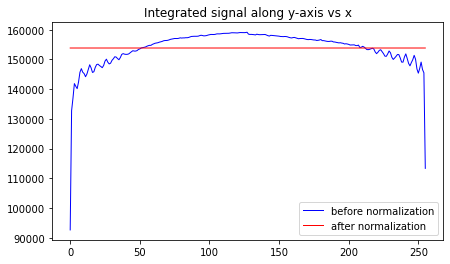

Minimum of normalized background: 589.9309692382812
Maximum of normalized background: 1049.884521484375
Mean of normalized background: 603.3587006255984
Standard deviation of normalized background: 2.359022730021082

Total number of bad pixels: 14

[[   0.            0.          618.41662598]
 [ 246.            0.          608.46368408]
 [ 255.            0.          616.00073242]
 [ 164.           18.          612.64746094]
 [  77.           21.          609.28869629]
 [ 180.           26.          722.57562256]
 [ 239.           30.          608.42126465]
 [ 151.           40.          608.85821533]
 [ 154.          109.          612.24639893]
 [ 172.          127.          609.04034424]
 [ 141.          136.          628.47509766]
 [  30.          143.          612.63830566]
 [ 207.          197.         1049.88452148]
 [  20.          203.          640.87390137]]


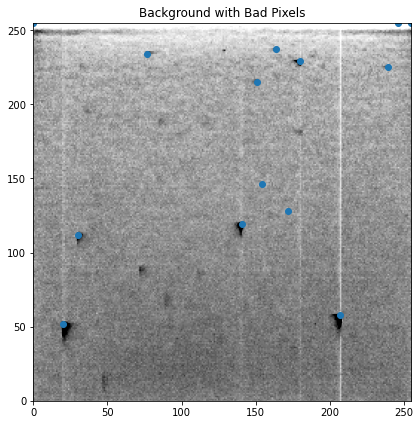

In [15]:
# Set this value to identify pixels from the background data that are Bsig > Mean
# Adjust to target ~ 30 bad pixels
Bsig = 2 
bad_pixels_mat, number_bad = turbulence.find_bad_pixel(BackAvg, Bsig)

## Find peaks above threshold n x sigma above background

In [16]:
nsig = 4
peaks_list, total_peaks = turbulence.find_peaks(nsig, SpeNet, InputFile)

Threshold = 60 and n-sigma = 4
Total number of frames: 1000



/Applications/anaconda3/lib/python3.8/site-packages/astropy/table/table.py:3197: FutureWarning: elementwise == comparison failed and returning scalar instead; this will raise an error or perform elementwise comparison in the future.
  result = self.as_array() == other


Total number of peaks: 48749


## Remove peaks near pixel defects and store the remaining peaks in peaks_mat_nobad list.

Number of peaks before culling: 48749
before: 48749
after: 47474
Total number of peaks left: 47474


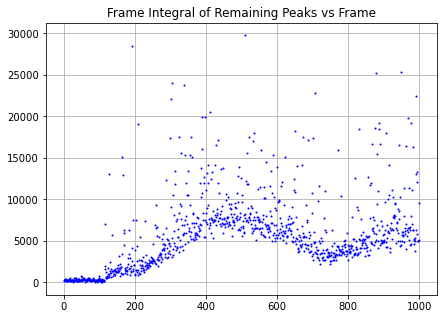

In [17]:
Radius = 3 # Remove peaks fall in this Radius and store the remaining peaks in peaks_mat_nobad list.
peaks_mat_nobad = turbulence.remove_bad_pixels(Radius, SpeNet, bad_pixels_mat, number_bad, InputFile, peaks_list, total_peaks, TimeStampArray)
# print(peaks_mat_nobad)

## Display frame and image with peaks found (Figure. S3)
The peak frames will be created and stored under '/peak_frames' subdirectory

In [18]:
importlib.reload(turbulence)
os.chdir(DefaultDir)
axis = True
turbulence.display_good_peaks(SpeNet, peaks_mat_nobad,TimeStampArray, InputFile, axis)

Created Directory :  /Users/mf3/Dropbox (ORNL)/Project Turbulent Flow/Our Papers/SecondPaper/DataRepository/example_for_mike_to_test//peak_frames


## Make countour plots if need

In [19]:
# importlib.reload(turbulence)
# binning = 4 # binning 4x4 or (256/4, 256/4) pixels
# TimeWindow = 0.5
# Vmax = 200 ###### Change Vmax for best viewing contrast
# Levels = np.linspace(160, 180, 1, dtype = np.float32)
# xLimit = 200
# yLimit = 200
# turbulence.contour_plot(InputFile, SpeNet, binning, TimeStampArray, TimeWindow, Vmax, Levels=np.linspace(20, 30, 1, dtype = np.float32), xLimit = 200, yLimit = 200)

## Make Integrated movies (Figure. S2)
By running this step, a integrated movie will be created and store in '/integrated_movie_frams' subdirectory. Each frame in this movie is integrated over 'TimeWindow' seconds.

Created Directory :  /Users/mf3/Dropbox (ORNL)/Project Turbulent Flow/Our Papers/SecondPaper/DataRepository/example_for_mike_to_test//integrated_movie_frames
0 35 7.986249 25.968326 0.5


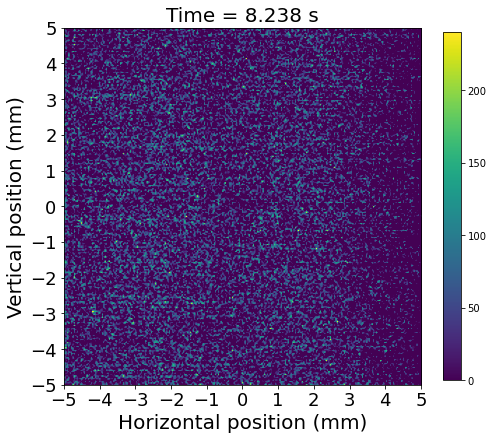

1 35 7.986249 25.968326 0.5


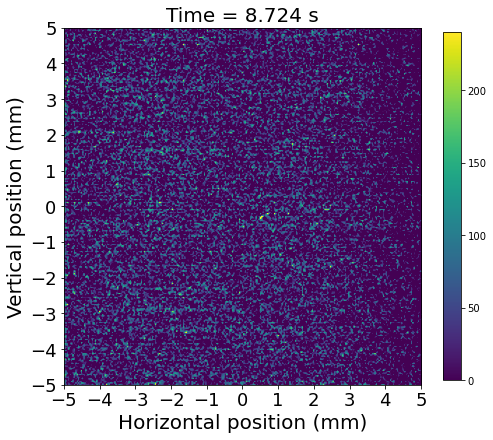

2 35 7.986249 25.968326 0.5


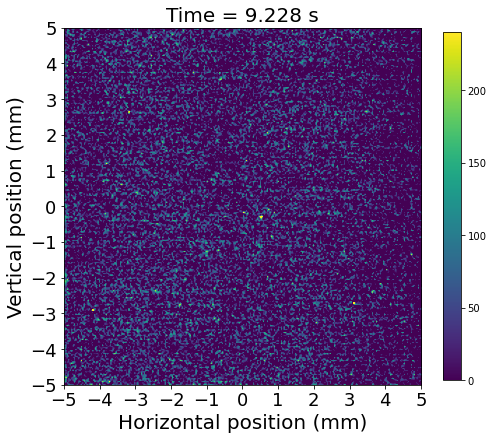

3 35 7.986249 25.968326 0.5


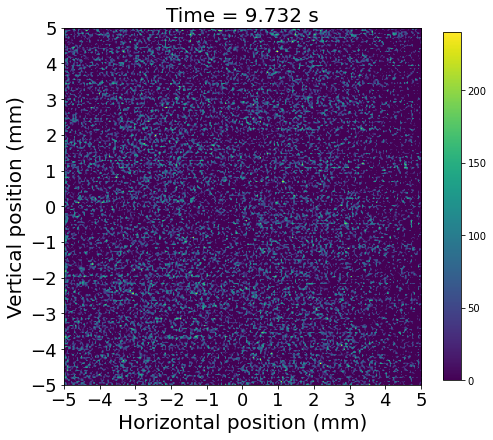

4 35 7.986249 25.968326 0.5


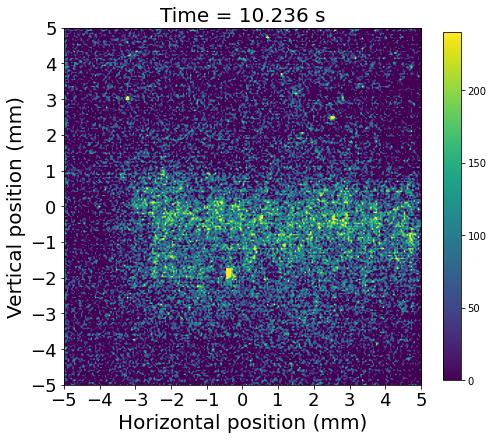

5 35 7.986249 25.968326 0.5


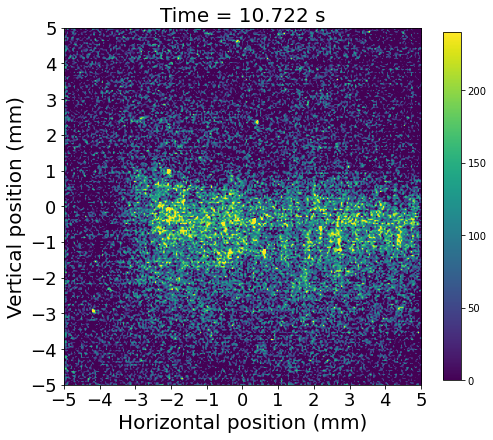

6 35 7.986249 25.968326 0.5


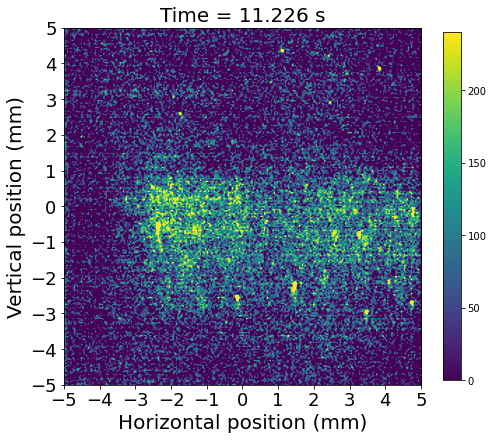

7 35 7.986249 25.968326 0.5


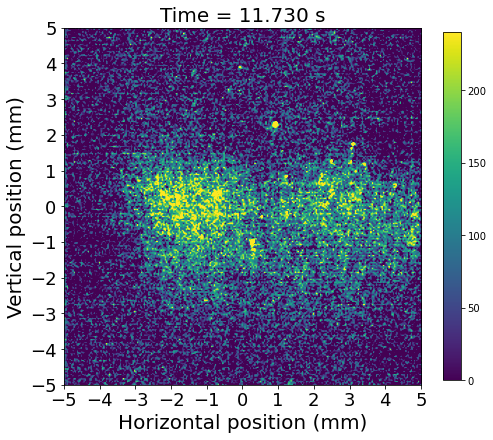

8 35 7.986249 25.968326 0.5


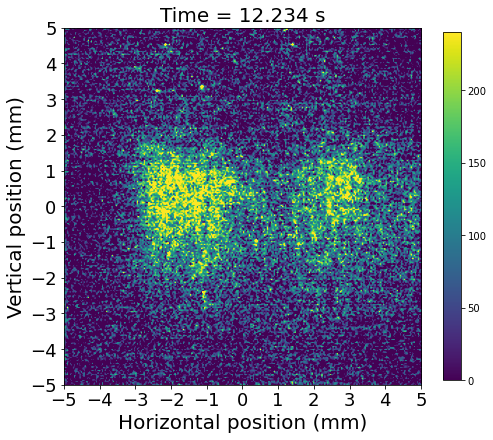

9 35 7.986249 25.968326 0.5


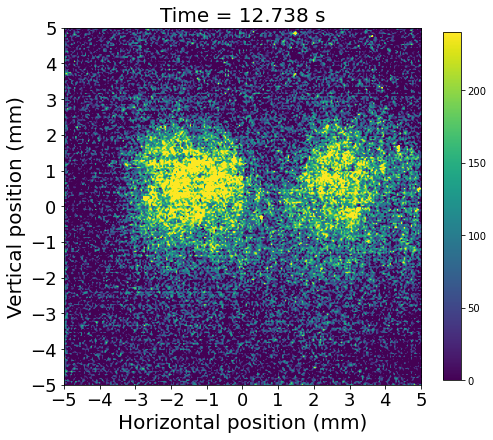

10 35 7.986249 25.968326 0.5


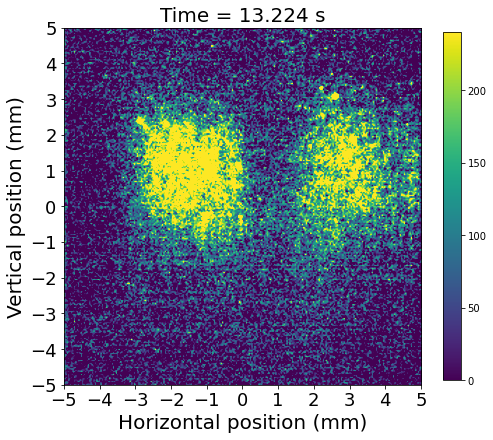

11 35 7.986249 25.968326 0.5


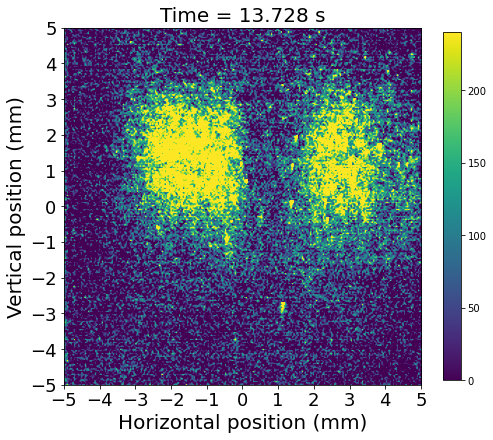

12 35 7.986249 25.968326 0.5


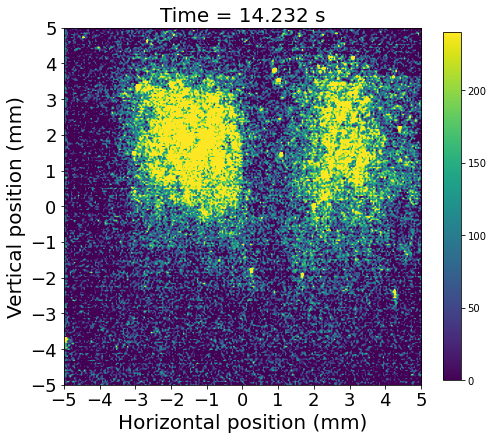

13 35 7.986249 25.968326 0.5


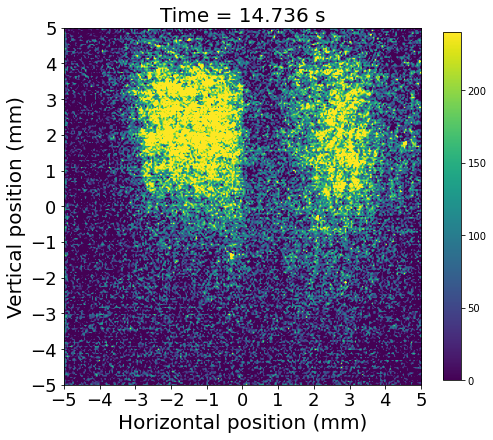

14 35 7.986249 25.968326 0.5


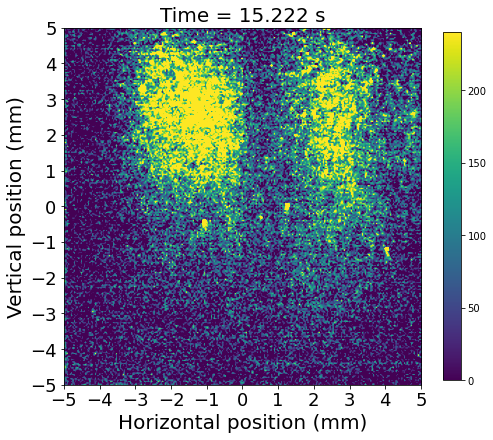

15 35 7.986249 25.968326 0.5


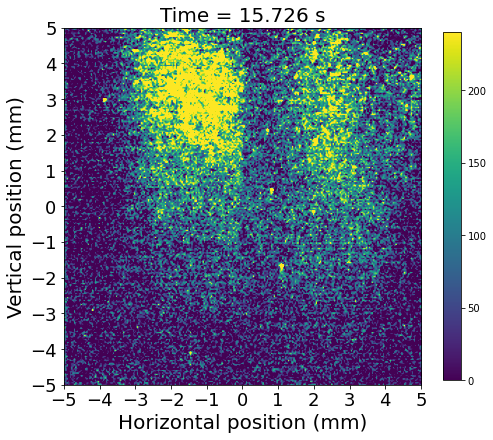

16 35 7.986249 25.968326 0.5


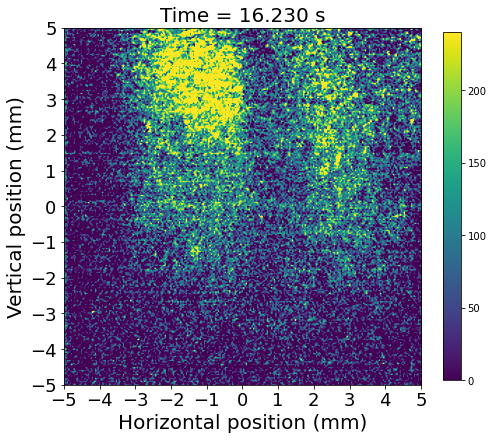

17 35 7.986249 25.968326 0.5


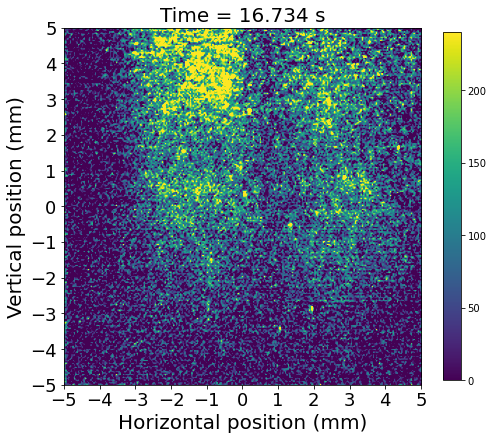

18 35 7.986249 25.968326 0.5


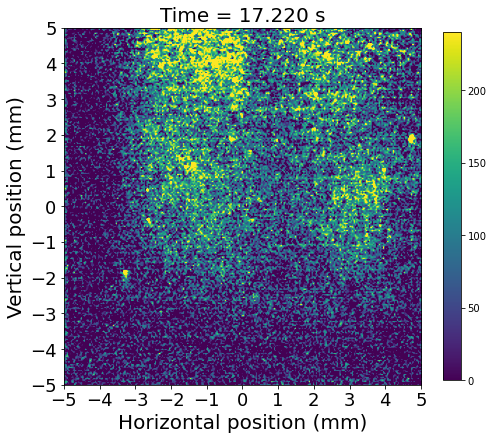

19 35 7.986249 25.968326 0.5


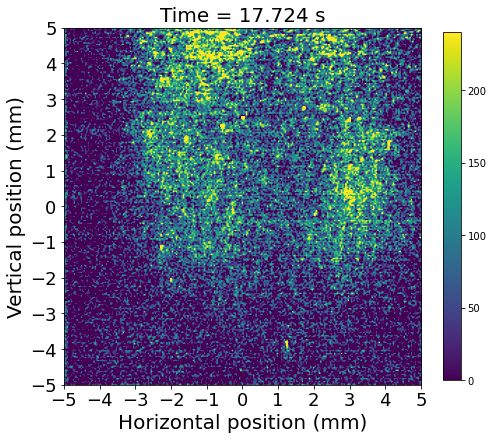

20 35 7.986249 25.968326 0.5


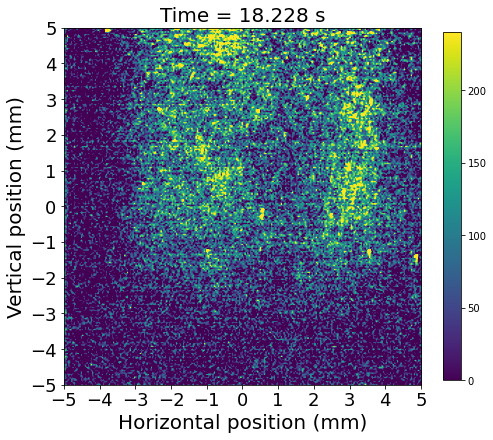

21 35 7.986249 25.968326 0.5


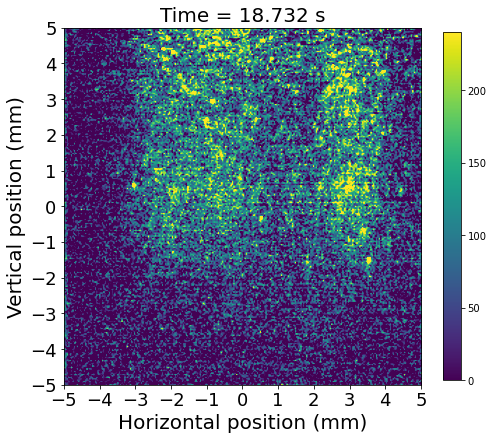

22 35 7.986249 25.968326 0.5


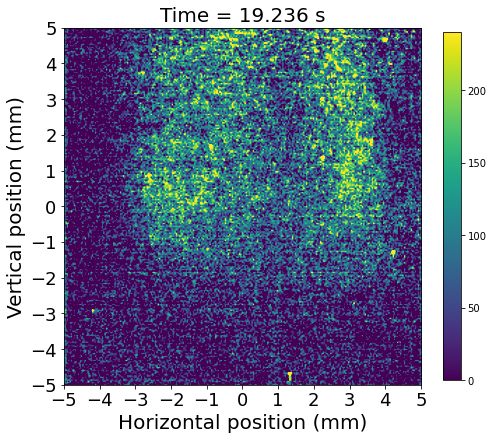

23 35 7.986249 25.968326 0.5


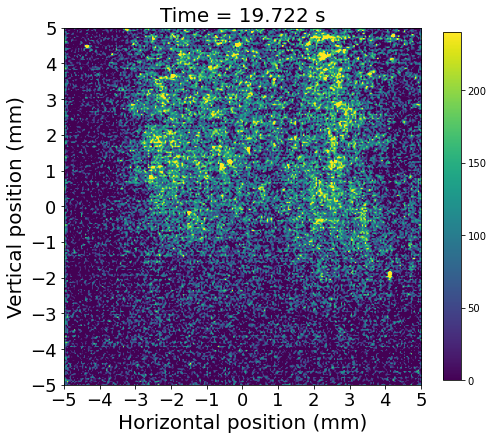

24 35 7.986249 25.968326 0.5


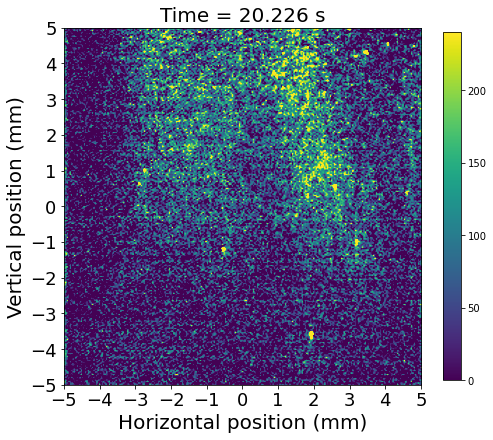

25 35 7.986249 25.968326 0.5


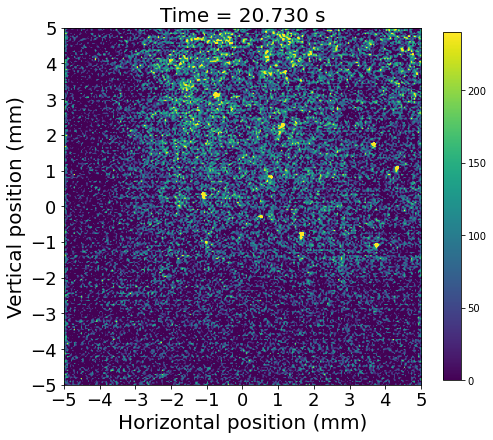

26 35 7.986249 25.968326 0.5


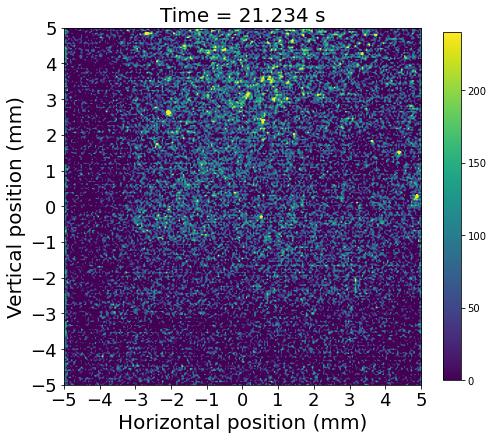

27 35 7.986249 25.968326 0.5


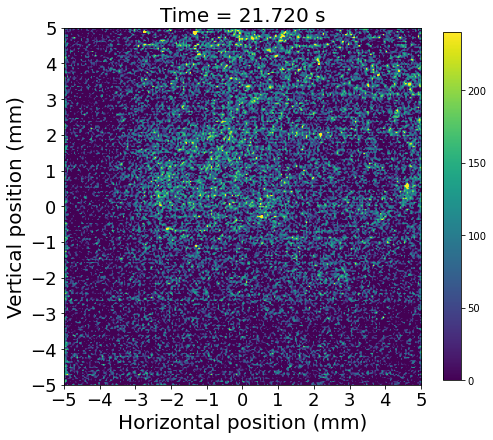

28 35 7.986249 25.968326 0.5


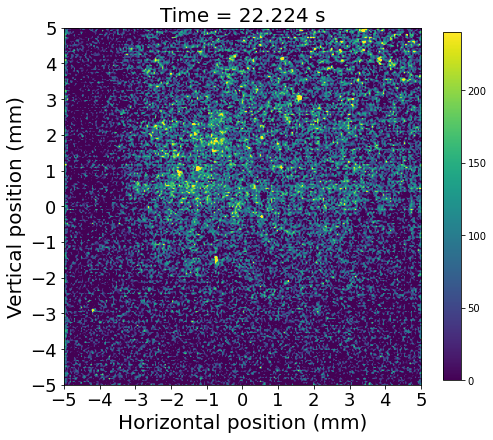

29 35 7.986249 25.968326 0.5


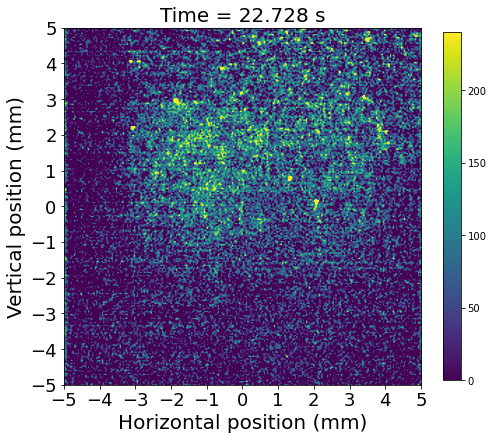

30 35 7.986249 25.968326 0.5


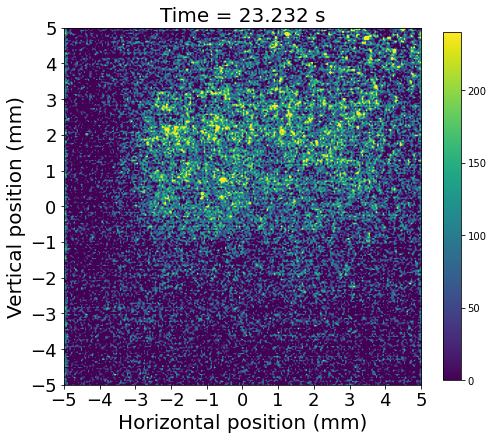

31 35 7.986249 25.968326 0.5


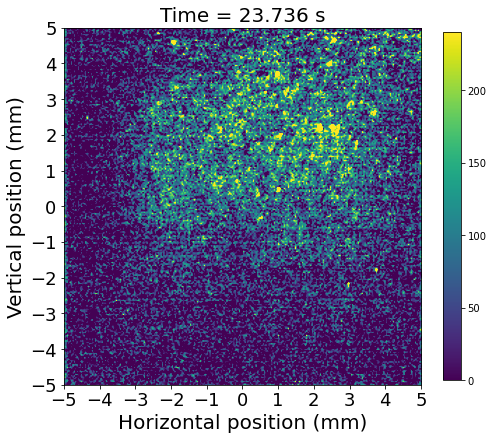

32 35 7.986249 25.968326 0.5


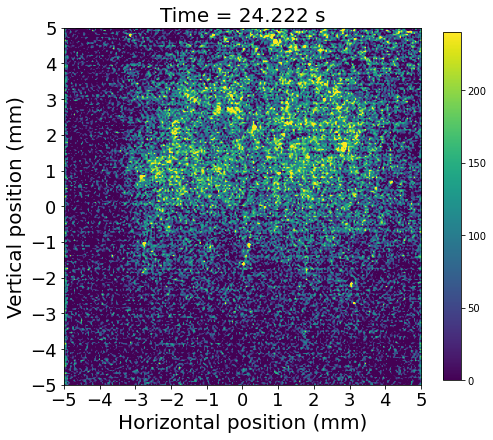

33 35 7.986249 25.968326 0.5


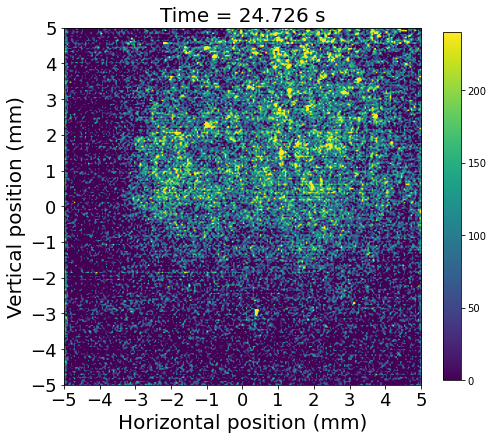

34 35 7.986249 25.968326 0.5


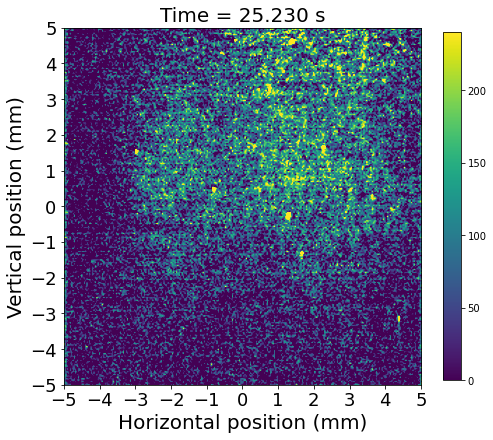

35 35 7.986249 25.968326 0.5


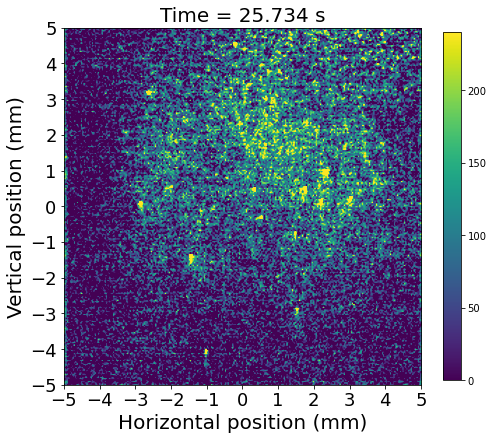

In [20]:
importlib.reload(turbulence)
TimeWindow = 0.5 # Each frame is integrated over a 0.5s time window
Vmax = 240 ###### Change Vmax for better viewing contrast
VProjection = turbulence.display_integrated_frames(InputFile, SpeNet, TimeStampArray, TimeWindow, Vmax = 240)

## Make a movie of SpeNet, if desired

In [21]:
# importlib.reload(turbulence)
# Vmax = 40 ###### Change Vmax for best viewing contrast
# turbulence.display_net_frames(SpeNet, InputFile, TimeStampArray, Vmax = 40)

## Plot the signal vs vertical position and time, if desired

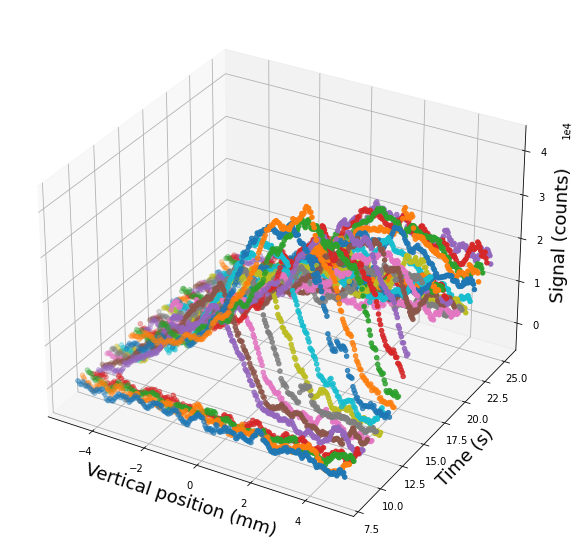

In [22]:
importlib.reload(turbulence)
turbulence.threeD_plot(InputFile, SpeNet, VProjection, TimeWindow, TimeStampArray)

## Show an image of the signal vs time and (left) vertical and (right) horizontal position
## Show a smoothed image of the signal vs time and (left) vertical and (right) horizontal position

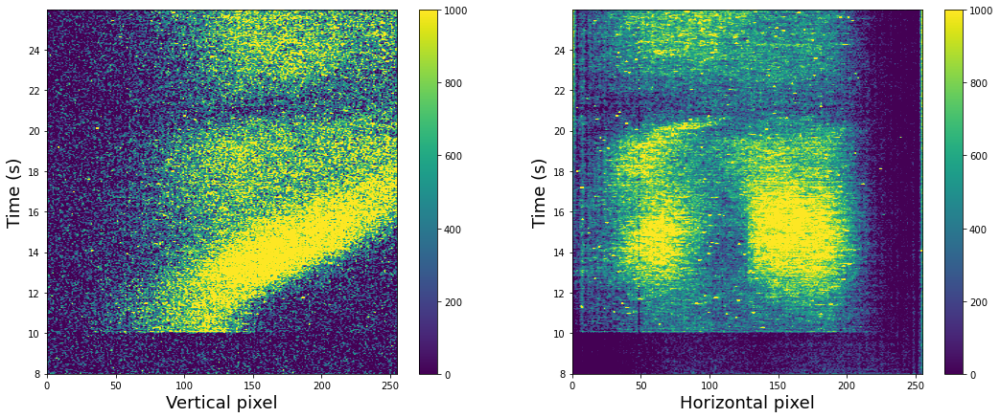

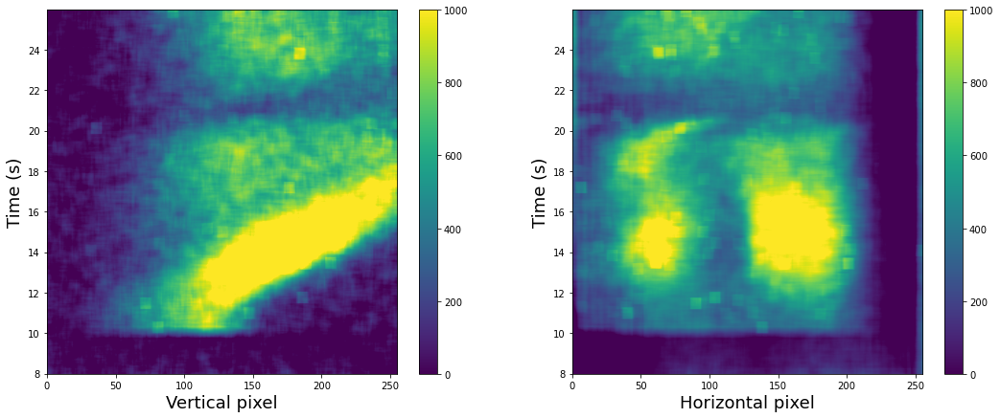

In [23]:
importlib.reload(turbulence)
Vmax = 1000 ###### Change Vmax for best viewing contrast
turbulence.integrated_plot(SpeNet, InputFile, TimeStampArray, Vmax = 1000)

In [24]:
gc.collect() # Release memory

3207427

# Clustering Routine (Figure. S5)
By running this step, a text file containing cluster information will be generated and stored in the main directory named after Filename +'cluster_results.txt'.
Cluster frames along with a movie (Figure. S5) will be created and store under '/cluster_frams' subdirectory. 

## Application of MeanShift code

This section creates an array X that has the locations of all the peaks

X array is used for the clustering algorithms.

Weight is an array of the intensities which is used only with option for k-means

iter_frame is the frame number to perform clustering.  this should vary in range of total_frame_numbers

In [25]:
os.chdir(DefaultDir) 
importlib.reload(turbulence)
frame_format = 'jpg'
n_cluster_min = 2 # there must be more than this number of events to qualify as a reported cluster
turbulence.clustering(SpeNet, InputFile, BackFile, nsig, TimeStampArray, peaks_list, n_cluster_min, 'auto', quantile = 0.1, frame_format = 'jpg')

Created Directory :  /Users/mf3/Dropbox (ORNL)/Project Turbulent Flow/Our Papers/SecondPaper/DataRepository/example_for_mike_to_test//cluster_frames
XML Footer was not loaded prior to calling _get_wavelength or 
XML Footer does not contain Wavelength Mapping information
Successfully loaded 1 file(s) in a SpeFile object
Frame = 0
Estimated bandwidth: 0.000
Frame = 1
Estimated bandwidth: 0.000
Frame = 2
Estimated bandwidth: 0.000
Frame = 3
Estimated bandwidth: 0.000
Frame = 4
Estimated bandwidth: 0.000
Frame = 5
Estimated bandwidth: 0.000
Frame = 6
Estimated bandwidth: 0.000
Frame = 7
Estimated bandwidth: 0.000
Frame = 8
Estimated bandwidth: 0.000
Frame = 9
Estimated bandwidth: 0.000
Frame = 10
Estimated bandwidth: 0.000
Frame = 11
Estimated bandwidth: 0.000
Frame = 12
Estimated bandwidth: 0.000
Frame = 13
Estimated bandwidth: 0.000
Frame = 14
Estimated bandwidth: 0.000
Frame = 15
Estimated bandwidth: 0.000
Frame = 16
Estimated bandwidth: 0.000
Frame = 17
Estimated bandwidth: 0.000
Frame

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 117    0    5   218.00    23.09   144.00   111.00    22.46     530.34
 117    1    3   184.33    17.67   119.67   135.33    13.32     309.03
Frame = 118
Estimated bandwidth: 0.000
Frame = 119
Estimated bandwidth: 0.000
Frame = 120
Estimated bandwidth: 0.000
Frame = 121
Estimated bandwidth: 0.000
Frame = 122
Estimated bandwidth: 0.000
Frame = 123
Estimated bandwidth: 28.580
Estimated number of clusters: 17
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126

Estimated bandwidth: 31.116
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197
 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215
 216 217 218 219 220 221 222 223 224 225 226 227 228 229 23

Frame = 168
Estimated bandwidth: 31.098
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197
 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215
 216 217 218 219 220 221 222 223 224 225 226 22

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 184    0    6   111.60    12.38   130.00   125.00    22.15     390.12
 184    1    3    65.67     6.03   119.67   135.33    23.63     186.16
Frame = 185
Estimated bandwidth: 0.000
Frame = 186
Estimated bandwidth: 0.000
Frame = 187
Estimated bandwidth: 24.197
Estimated number of clusters: 16
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 195    0    5   179.00     8.69   148.25   106.75    25.05     346.38
 195    1    3   248.00     5.57   142.33   112.67     1.53     202.83
 195    2    3   220.67    19.43    37.33   217.67    16.07     249.99
Frame = 196
Estimated bandwidth: 0.000
Frame = 197
Estimated bandwidth: 20.304
Estimated number of clusters: 15
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 210    0    3   154.33    17.01   177.00    78.00     6.08     191.41
 210    1    3    53.33    12.42   121.67   133.33    16.07     216.34
Frame = 211
Estimated bandwidth: 0.000
Frame = 212
Estimated bandwidth: 29.582
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 1

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 219    0    4   212.75     9.07    99.25   155.75    15.42     275.04
 219    1    5    96.50    15.87   107.25   147.75    11.25     529.59
 219    2    3   154.67     8.08   104.33   150.67     2.31     194.54
 219    3    4   111.00    12.27    27.33   227.67    16.66     285.53
Frame = 220
Estimated bandwidth: 31.740
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 227    0    5   235.20    11.70   111.00   144.00    20.63     342.52
 227    1    3   181.20    13.01    19.60   235.40    12.36     234.49
 227    2    4   199.75     9.32   113.00   142.00    14.02     400.13
 227    3    5    99.50    24.60   104.50   150.50    10.26     341.85
 227    4    3   222.67    17.90    15.67   239.33    11.02     251.15
 227    5    3   162.00    15.72   141.67   113.33    10.02     188.91
 227    7    3    70.00     7.00    24.33   230.67    18.88     199.83
Frame = 228
Estimated bandwidth: 27.626
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 233    0    5   188.17    10.43   104.00   151.00    19.51     351.69
 233    1    8    74.33    26.18   102.83   152.17    22.26     515.15
 233    2    4   241.50    17.46   111.00   144.00    22.08     294.30
 233    3    4   217.75    18.98    38.50   216.50     3.11     284.57
 233    4    3   149.00    17.69    17.00   238.00    20.66     327.92
Frame = 234
Estimated bandwidth: 21.357
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 239    0    6    76.20    15.53   105.40   149.60    13.41     460.10
Frame = 240
Estimated bandwidth: 24.807
Estimated number of clusters: 15
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 19

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 245    0   16    76.43    14.99   109.21   145.79    12.10    1065.23
 245    1    3   200.00     5.57    87.67   167.33     4.16     200.74
Frame = 246
Estimated bandwidth: 33.660
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 1

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 251    0    9   200.29    18.98   104.14   150.86    14.94     655.69
 251    1    3   128.40    11.36    99.20   155.80     5.68     190.53
 251    2    5    66.40     9.13   138.60   116.40    13.78     625.46
 251    3    3   169.33     9.45    13.67   241.33    15.01     364.08
 251    4    3   135.00     2.00    67.00   188.00    11.36     183.72
 251    5    3    32.00    18.03    55.00   200.00     1.73     190.95
Frame = 252
Estimated bandwidth: 29.923
Estimated number of clusters: 14
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 257    0   11   104.40    13.75   112.00   143.00    10.00    5076.90
 257    1   10   197.62    19.60   122.12   132.88    19.47     691.68
 257    2    5    66.40    17.39    81.20   173.80    10.76     354.10
Frame = 258
Estimated bandwidth: 27.436
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 15

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 263    0    7   115.00    11.17   126.86   128.14    10.42     455.91
 263    1    6    71.67    12.53   103.83   151.17    12.16     387.84
 263    2    6   182.25    16.78    79.25   175.75    19.46     408.66
 263    3    3   243.33     7.23   103.33   151.67     3.06     244.24
 263    4    3   100.33     8.39    42.33   212.67    12.66     257.01
Frame = 264
Estimated bandwidth: 25.128
Estimated number of clusters: 14
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 269    0    8   195.00    10.27    88.86   166.14    19.54     576.84
 269    1    6    75.00    17.03    94.17   160.83     7.63     391.17
 269    2    5   172.40    20.23    36.20   218.80    14.20     468.62
 269    3    5   223.00    21.55   142.00   113.00    13.51     386.67
 269    4    3   131.33    11.55   115.00   140.00    10.58     200.95
Frame = 270
Estimated bandwidth: 28.455
Estimated number of clusters: 16
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 275    0    6   210.20    13.22   143.20   111.80    14.51     393.40
 275    1    3    66.00     6.93    81.33   173.67     3.51     235.41
 275    2    3    63.00     2.65   125.67   129.33    11.72     196.80
Frame = 276
Estimated bandwidth: 36.610
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 15

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 281    0   10   232.22    14.07    67.00   188.00    14.22    1486.55
 281    1   10   106.22    19.97    92.33   162.67    18.30     650.32
 281    2    5   195.50     9.69   122.00   133.00    20.24     345.44
 281    3    7    88.25    27.15   128.50   126.50    11.21     469.74
 281    5    3    63.50     5.33    11.00   244.00    34.43     339.79
 281    6    4   176.00    26.90    58.00   197.00    22.26     249.57
Frame = 282
Estimated bandwidth: 31.503
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 287    0    9    75.29    23.35   100.86   154.14    12.57     677.50
 287    1    7   202.50    11.83    81.67   173.33    17.97   10126.90
 287    2    4   210.00    19.06   116.60   138.40     7.24     317.48
 287    3    3   135.00    24.38    41.33   213.67    17.90     211.65
 287    4    3    89.00     7.81   135.33   119.67    17.50     245.90
Frame = 288
Estimated bandwidth: 22.509
Estimated number of clusters: 16
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 293    0    8    78.10    11.76   111.80   143.20    14.11     841.35
 293    1   10   202.33    14.55    98.00   157.00    12.11     793.68
 293    2    9    82.86    19.65    83.00   172.00    10.29     641.37
 293    3    3   246.33     3.06   109.00   146.00    15.72     207.36
 293    4    3   136.00     4.36    39.33   215.67     5.13     217.32
Frame = 294
Estimated bandwidth: 18.992
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 298    0   10   197.75    12.12    80.92   174.08    16.34     887.67
 298    1    9    79.89    14.46   115.44   139.56     9.86     628.15
 298    2    8   172.57    22.20    36.29   218.71    18.45   13861.20
 298    3    5   233.40    13.92   137.40   117.60    17.67     351.45
 298    4    6    59.25    17.46    48.25   206.75    27.87     502.85
 298    5    4   233.00    12.00    47.67   207.33    25.95     311.52
 298    6    4   228.67    25.30   211.67    43.33     6.81     280.59
 298    7    3   142.67    22.24   107.33   147.67    28.87     193.37
Frame = 299
Estimated bandwidth: 32.159
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 304    0   11    94.44    14.97    80.44   174.56    14.76     760.10
 304    1    5   229.80    15.63    31.60   223.40    16.61     413.14
 304    2    5   188.40    15.87    58.00   197.00    10.17   20979.40
 304    3    3   188.00    13.08    28.80   226.20    15.72     184.42
 304    4    4   226.75    10.50   109.75   145.25    12.45     323.52
 304    5    4   168.25    11.53    93.75   161.25     8.62     292.40
 304    6    5    59.25    13.39    98.50   156.50    26.37     414.54
Frame = 305
Estimated bandwidth: 30.974
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 309    0   21   193.81    15.48    85.12   169.88    24.23    1659.32
 309    1   12    94.70    20.41    92.70   162.30    15.64    1416.05
 309    2    9   233.11    16.57    46.78   208.22    10.94    1487.40
 309    3    5   205.60    20.62    19.60   235.40    15.93     587.97
 309    4    5    66.00    20.06    12.20   242.80     9.23     489.15
 309    5    3   122.33     0.58   224.67    30.33     7.64     315.07
Frame = 310
Estimated bandwidth: 27.933
Estimated number of clusters: 14
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 314    0   13   201.69    12.81    71.15   183.85    14.85    8808.15
 314    1   16    89.00    17.80    76.85   178.15    19.04    1132.51
 314    2    5   134.40    16.36    17.40   237.60    10.45     480.11
 314    3    4   243.00     9.02    83.25   171.75     7.50     372.33
 314    4    4   203.50     7.05   119.75   135.25     7.14     295.18
Frame = 315
Estimated bandwidth: 32.391
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 319    0   16    74.93    10.29    80.14   174.86    17.20    1159.43
 319    1   13   193.64    17.91    84.82   170.18    21.24     985.69
 319    2    9   106.75    21.04   105.62   149.38    13.60     631.40
 319    3    6   230.00    17.67    65.67   189.33    13.11     422.15
 319    5    3    61.33    18.04    18.67   236.33     9.07     324.91
 319    7    3   100.00    24.09   147.50   107.50    11.55     191.56
Frame = 320
Estimated bandwidth: 27.856
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 324    0   26    80.62    15.84    91.14   163.86    15.74    2291.77
 324    1    9   194.11    13.24    90.22   164.78    15.97     697.17
 324    2   13   172.56    26.37    33.22   221.78    17.03    1111.87
 324    3    8   214.25    13.52    64.38   190.62    11.24   12013.87
 324    4    3   248.00     8.89    21.33   233.67     3.79     399.17
 324    5    3   243.33    11.72   138.33   116.67     7.51     200.72
 324    6    5    55.50    36.40    19.00   236.00    17.97     565.90
Frame = 325
Estimated bandwidth: 24.788
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 329    0   12   212.92    17.46    63.62   191.38    19.99    1063.73
 329    1    8    84.64    13.86    72.09   182.91    12.83    5199.97
 329    2   10    66.11    22.79    96.56   158.44    14.55     791.85
 329    3    7   207.50    18.74   126.17   128.83    16.91     478.12
 329    4    4   184.83     7.35    18.00   237.00    17.37     381.67
 329    5    5   132.00    17.66    55.50   199.50    13.37     421.69
 329    6    4   188.40    10.38    89.80   165.20    19.24     282.72
 329    7    4   140.40    15.14    26.00   229.00    13.98     298.04
 329    8    3   138.00    24.74   187.50    67.50    23.20     190.17
Frame = 330
Estimated bandwidth: 37.721
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  5

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 334    0   10   196.60    11.91    77.50   177.50    16.26     808.47
 334    1    6   192.25    12.21    50.62   204.38     9.78     462.07
 334    2    5    81.57    12.54    97.71   157.29    10.25     347.05
 334    3    6    70.43     9.01    47.29   207.71     7.46     439.87
 334    4    4   103.17    22.90    78.17   176.83    12.79     264.54
 334    5    5   183.60     8.62    21.80   233.20     7.95     407.29
 334    6    5   117.20     7.36    44.80   210.20    21.92     454.37
 334    7    4    92.00    17.13   123.00   132.00     8.85     277.19
 334    8    3    67.00    18.63    17.50   237.50    10.27     239.05
Frame = 335
Estimated bandwidth: 31.254
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  5

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 339    0   23   209.18    21.34    58.71   196.29    21.44    1942.30
 339    1   12    85.27    13.59    72.45   182.55    16.48     856.05
 339    2    9   150.29    24.33    62.14   192.86    23.38     955.74
 339    3    5   170.00    16.90    15.00   240.00    11.18     392.53
 339    4    5    52.00    17.31   100.40   154.60    18.10    2058.47
 339    5    4   230.00    17.80     5.00   250.00    29.18     343.87
Frame = 340
Estimated bandwidth: 22.026
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 345    0   22   202.38    16.48    46.19   208.81    17.78    3225.38
 345    1   24    91.06    17.25    64.00   191.00    25.16    1866.06
 345    2    9   225.56    16.13    80.00   175.00    16.43     724.01
 345    3    6   231.50     9.93   119.62   135.38    16.82     566.43
 345    4    8   151.25    22.20    68.25   186.75    25.84     735.62
 345    5    4    32.50    22.25    21.00   234.00    12.91     268.22
 345    6    3   182.00    43.23   141.00   114.00    31.54     219.62
 345    7    3   129.00    37.02    10.00   245.00    16.45     302.43
Frame = 346
Estimated bandwidth: 28.182
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 350    0   10   210.50    13.60   100.50   154.50     9.20     899.15
 350    1   11   191.80     9.09    37.70   217.30    21.91    1275.67
 350    2    9    98.40    10.80    54.80   200.20    10.76     621.33
 350    3    6    91.75    17.89    83.88   171.12    17.58     436.33
 350    4    8    64.12    13.43    22.50   232.50     7.96     614.63
 350    5    5   130.00    12.14    17.50   237.50    22.92     497.83
 350    6    4    60.75    13.67    67.00   188.00     6.78     260.15
 350    8    3   165.00    10.00   100.33   154.67    11.68    5423.60
Frame = 351
Estimated bandwidth: 27.356
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 355    0   11   199.42     9.55    61.08   193.92    11.31     961.93
 355    1    7   106.12    10.79    51.12   203.88     9.24     980.92
 355    2    5   224.57    13.18    50.14   204.86     9.01     573.90
 355    3    6    91.50    12.96    72.67   182.33    11.14     481.50
 355    4    5    72.00    12.86    43.50   211.50     6.91     389.50
 355    5    4   145.00    12.33    33.25   221.75    11.32     335.23
 355    6    5    49.75    16.49    12.00   243.00    10.85     612.47
 355    7    4    48.75    15.29    69.25   185.75    17.04     269.22
 355    8    5   221.67    16.30   121.67   133.33    16.63     389.60
 355   10    3   196.00    12.37    25.50   229.50    14.19     202.64
Frame = 356
Estimated bandwidth: 30.243
Estimated number of clusters: 8
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 360    0   25   100.83    15.59    56.96   198.04    20.06    2009.68
 360    1   13   193.81    15.71    52.00   203.00    10.22    1092.68
 360    2   11   217.55    20.55    84.00   171.00    16.60     862.17
 360    3   12   180.82    17.11    19.18   235.82    10.92    9070.48
 360    4    8    79.22    13.03   100.33   154.67    12.17     555.77
 360    5    4   229.20     9.63    30.80   224.20    12.91     347.88
 360    6    5   117.00     9.27   115.00   140.00    17.51     343.85
 360    7    4    45.67    16.86    50.67   204.33    11.96     500.17
Frame = 361
Estimated bandwidth: 28.814
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 365    0   23    82.67    17.79    75.47   179.53    18.10    1759.90
 365    1    6   210.82     5.66    53.91   201.09    11.09     854.48
 365    2   10   197.50    17.93    76.50   178.50    10.79     874.86
 365    3   11   177.50    16.42    19.90   235.10    11.73    1267.98
 365    4    6   162.12    13.25    50.00   205.00    13.68     536.73
 365    5    6   231.33     9.33    71.33   183.67    19.77     422.28
 365    6    3   229.33    13.05    24.00   231.00     7.55     198.60
 365    7    3   201.50    19.06   129.00   126.00    15.59     278.03
Frame = 366
Estimated bandwidth: 30.576
Estimated number of clusters: 6
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 370    0   24   189.42    22.94    33.05   221.95    18.30    2397.61
 370    1   27   102.94    23.22    62.12   192.88    29.01    2154.63
 370    2    7   224.00    14.35    86.50   168.50    24.26     567.30
 370    3    4   224.60    22.81   137.80   117.20     9.25     268.55
 370    4    3   178.33     5.51   108.00   147.00    16.52     183.51
Frame = 371
Estimated bandwidth: 27.520
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 376    0   31    89.62    22.13    44.67   210.33    18.89    2327.07
 376    1    8   196.30    13.42    26.50   228.50    10.13     821.66
 376    2    4   210.14    12.68    57.57   197.43    10.88     314.51
 376    3    5   239.60    12.01    59.40   195.60    17.36     366.16
 376    4    4   152.80    20.13    15.60   239.40    10.10     404.59
 376    5    7   141.60    17.88    51.80   203.20    25.56     884.45
 376    6    3   198.67    11.93   124.67   130.33     3.21     203.63
Frame = 377
Estimated bandwidth: 29.845
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 381    0   17   187.44    15.72    37.56   217.44    18.66    1586.46
 381    1   12    92.50    12.90    61.83   193.17    10.38     933.56
 381    2   10   215.82    17.40    25.91   229.09    14.04    1436.44
 381    3   11   199.18     9.16    92.09   162.91    13.70     847.59
 381    4   11    55.75    11.51    30.25   224.75    23.48     777.89
 381    5    5   105.67    16.94    32.00   223.00     8.44     375.84
 381    6    3   138.33    12.50    93.00   162.00    13.00     208.28
 381    7    3   136.00    28.29   128.00   127.00    11.02     198.43
Frame = 382
Estimated bandwidth: 29.834
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 386    0   10   198.73    16.32    58.00   197.00    16.09     745.86
 386    1   18    93.36    16.43    41.07   213.93    22.70    1491.54
 386    2   11   190.50    21.63    25.25   229.75    14.72    1141.40
 386    3    8   183.92    14.05    86.08   168.92    10.13     607.94
 386    4    7    67.29    21.43    71.86   183.14    13.03    2444.46
 386    5    4   195.20    11.01   115.80   139.20    19.17    5923.73
 386    6    4   230.67    11.13     4.67   250.33    21.01    1019.97
 386    7    3    80.00    14.00   121.67   133.33    11.68     187.84
Frame = 387
Estimated bandwidth: 29.033
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 391    0   16    84.33    14.42    33.33   221.67    12.61    1403.46
 391    1   18   225.00    12.91    38.57   216.43    19.93    2095.03
 391    2   14   184.08    15.36    62.67   192.33    14.83    1482.72
 391    3   14    88.92    17.72    74.08   180.92    10.73    1098.17
 391    4    7   181.57    11.72    22.86   232.14     9.35     662.05
 391    5    3    61.00    14.80     7.67   247.33     9.07     345.72
Frame = 392
Estimated bandwidth: 30.809
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 1

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 397    0   42   182.71    30.20    35.79   219.21    24.00    4759.23
 397    1   13    90.78    21.39    25.89   229.11    15.91    1195.48
 397    2   12    60.00    15.08    31.47   223.53    11.51    1258.36
 397    3   13    82.43    19.19    57.21   197.79    14.19     892.37
 397    4    5    98.80    12.52   145.40   109.60     6.39   11100.39
 397    5    4   217.33    17.10   129.00   126.00    20.58     301.98
 397    6    5   122.00    31.30    96.50   158.50    22.02     415.66
Frame = 398
Estimated bandwidth: 29.724
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 402    0   27    94.96    15.65    40.96   214.04    17.68    2216.36
 402    1   19    92.10    18.88    79.33   175.67    15.05    7082.06
 402    2   15   198.14    15.64    56.43   198.57    19.65    1153.56
 402    3    8   224.11    16.93    30.11   224.89    20.81    1186.52
 402    4    7   178.50    20.35    16.50   238.50    14.58     648.67
 402    5    3   102.67     5.51   162.00    93.00    22.27     214.64
Frame = 403
Estimated bandwidth: 30.492
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 408    0   19   187.56    14.26    32.88   222.12    25.48    1688.31
 408    1   13    61.79    17.60    28.43   226.57    13.35    1367.89
 408    2   10   100.73    17.00    54.27   200.73    15.50     718.13
 408    3    8   222.38    20.17    21.00   234.00    29.60     756.70
 408    4    8   130.50    22.98    31.83   223.17    27.48    1307.83
 408    5    5   148.00    27.75   133.00   122.00    22.06     396.03
Frame = 409
Estimated bandwidth: 30.675
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 413    0   35   193.86    24.27    31.76   223.24    30.34    3135.22
 413    1   20   105.64    21.71    60.86   194.14    31.13    1538.67
 413    2   14    70.00    20.76    47.60   207.40    34.87    1069.45
Frame = 414
Estimated bandwidth: 29.307
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 419    0   33    87.27    29.04    33.23   221.77    19.43    3524.32
 419    1   32   222.63    28.49    49.05   205.95    26.06    3357.52
 419    2   12    74.70    25.49    95.70   159.30    15.23     780.06
 419    3    8   210.56    20.40    99.44   155.56    25.44     542.44
Frame = 420
Estimated bandwidth: 30.570
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 425    0   17   109.88     7.92    36.35   218.65    18.05    1745.95
 425    1   16   174.44    16.58    13.50   241.50    10.98    1746.25
 425    2   13   192.25    17.94    62.83   192.17    12.43    1147.69
 425    3   10    82.58    11.89    21.92   233.08    14.79    1203.10
 425    4    5   224.17    16.06    14.83   240.17     9.96     540.19
 425    5    4   225.80    19.45    77.60   177.40     9.34     312.77
 425    6    6   186.60    18.71   116.00   139.00    14.63     409.09
 425    7    7    76.75    21.78    83.75   171.25    22.74     725.67
 425    8    3    27.33     5.03    17.33   237.67     8.50     229.05
Frame = 426
Estimated bandwidth: 34.768
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 431    0   13   192.71    13.83    19.29   235.71    12.69    1340.58
 431    1   19   106.62    22.83    27.38   227.62    12.50    1927.44
 431    2   16   186.00    14.18    53.38   201.62    27.75    1385.42
 431    3   11   232.33    15.90    27.92   227.08    17.43    1416.65
 431    4    9    92.50    17.44    60.90   194.10    17.10    1409.53
 431    8    4    36.00    16.51    71.00   184.00    42.74     351.70
Frame = 432
Estimated bandwidth: 29.721
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 437    0   33    91.26    23.82    21.11   233.89    15.62    3364.39
 437    1   19   195.06    25.75    31.44   223.56    16.18    1753.62
 437    2    8   227.80    18.23    68.40   186.60    28.15     544.35
 437    3    6    71.75    17.27   130.50   124.50    31.68     510.76
 437    4    3   171.33    20.31   108.00   147.00    14.73    2042.92
 437    5    5   129.67    26.53    96.33   158.67    32.03     415.00
Frame = 438
Estimated bandwidth: 30.568
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 443    0   22    71.36    16.13    18.64   236.36     9.01    6702.72
 443    1   14   106.69    16.13    22.19   232.81    10.99    1279.02
 443    2   14    83.21    12.95    51.14   203.86    15.00    1115.79
 443    3   12   181.85    15.37    61.08   193.92    12.17    1270.05
 443    4   10   172.50    14.37    14.00   241.00    11.72     993.65
 443    5    8   236.73     9.14    16.36   238.64     8.94     745.39
 443    6    6   206.00    11.89    12.45   242.55    10.08     664.55
 443    7    4   242.00     6.71    42.40   212.60    11.34     434.82
 443    8    4   160.33    21.10    94.33   160.67    16.23     282.13
Frame = 444
Estimated bandwidth: 27.652
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 448    0   12   115.29    12.07    24.14   230.86    10.10     968.57
 448    1    6   237.89     9.02    22.22   232.78    11.47     563.29
 448    2    6   208.22    12.32    28.11   226.89    13.42     569.49
 448    3    7    84.78    12.86    13.67   241.33     9.81     674.01
 448    4    6   174.43     9.14     5.14   249.86     4.67     902.41
 448    5    6    67.33    17.81    33.83   221.17     9.09     593.72
 448    6    4   231.00    12.25    51.60   203.40    14.43     537.92
 448    7    4   203.00    16.99    69.60   185.40     4.77     317.45
 448    8    3   164.67    11.24    40.33   214.67     6.35     236.50
Frame = 449
Estimated bandwidth: 26.902
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 453    0   29    87.30    22.12    28.65   226.35    18.39    2529.99
 453    1   21   176.24    11.94    20.94   234.06    23.04    2085.42
 453    2    7   228.83    12.82    51.00   204.00    26.43     854.26
 453    3    7    46.00     8.61    68.00   187.00    23.58     503.48
 453    4    5   200.00    17.28   107.60   147.40    12.48     315.14
Frame = 454
Estimated bandwidth: 29.485
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 458    0   25    86.52    22.10    22.71   232.29    13.18    2454.78
 458    1   14   105.36    19.62    48.71   206.29    13.50    1371.90
 458    2    7   190.11     9.81    19.11   235.89    10.43     656.65
 458    3    9    81.86    20.44    73.00   182.00    16.97     633.68
 458    4    7   232.80    18.30    61.40   193.60    12.52    1216.47
 458    5    6   163.60    17.21    12.40   242.60    17.25     764.31
 458    6    3   238.50     4.05    22.00   233.00    10.54     392.38
 458    7    3   211.00     6.36   139.00   116.00    30.99     220.78
Frame = 459
Estimated bandwidth: 30.774
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 463    0   29   192.57    20.95    26.91   228.09    18.90    2833.62
 463    1   16    94.00    22.54    15.79   239.21     8.48    1722.41
 463    2   11    94.73    28.58    51.18   203.82     8.74     834.07
 463    3   10   234.50    14.37    17.30   237.70    16.64    1165.19
 463    4   10    99.44    22.98    83.78   171.22    22.31     676.28
 463    5    4   143.75    12.04   175.25    79.75    14.93     290.29
Frame = 464
Estimated bandwidth: 26.927
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 469    0   38    79.83    28.72    21.00   234.00    13.96    3776.64
 469    1   29   208.56    27.75    32.33   222.67    19.38    3182.09
 469    2    6   200.00    24.59   120.00   135.00    21.73     426.48
 469    3    6    81.60    26.27   114.40   140.60    26.48     408.64
 469    4    3    65.33     3.21   162.00    93.00    19.08     196.60
Frame = 470
Estimated bandwidth: 29.500
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 475    0   20    76.65    14.41    22.48   232.52    15.17    1687.17
 475    1   17   113.29    14.08    19.57   235.43    15.53    1468.80
 475    2   18   214.00    17.82    26.44   228.56    17.72    2051.72
 475    3    8   127.12    13.74    82.25   172.75    18.16     621.14
 475    4    6   170.71    10.41    27.57   227.43    22.89     743.69
 475    5    4   198.00    15.38   138.00   117.00    23.74     249.33
Frame = 476
Estimated bandwidth: 31.499
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 480    0   19    74.55    15.29    21.70   233.30    14.30    1791.52
 480    1   20   109.47    16.96    26.42   228.58    18.49    2555.54
 480    2   10   176.62    13.09    23.23   231.77    16.29    1075.44
 480    3    8   166.50    11.01    54.00   201.00    11.12     620.67
 480    4    7   237.44    11.07    25.89   229.11    16.64     652.33
 480    5    5   228.57    14.57    57.00   198.00     9.37     526.39
 480    6    6   202.67    16.87   122.50   132.50    17.33     421.90
 480    7    4   197.33    15.54    74.67   180.33    15.73     280.83
Frame = 481
Estimated bandwidth: 31.978
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 485    0   30   104.83    20.62    24.96   230.04    17.74    2965.22
 485    1    9   155.73    17.57    14.73   240.27    16.40     887.70
 485    2    6   192.00    12.97    11.50   243.50    10.11     495.21
 485    3    6   229.14    16.30     9.86   245.14    11.48     462.55
 485    4    7   228.43    16.58   100.29   154.71    14.33     511.11
 485    6    4   109.25    16.15   103.00   152.00     6.78     432.14
 485    7    3   182.33    11.15    73.67   181.33    16.50     302.52
 485   10    6    42.00    14.28    61.00   194.00    44.57     480.57
Frame = 486
Estimated bandwidth: 30.419
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 490    0   13   111.42    17.42    17.21   237.79    11.90    1305.79
 490    1   19   191.94    26.73    16.94   238.06     9.64    2322.00
 490    2   13    80.19    15.06    25.19   229.81    12.19    1469.75
 490    3    4   189.60    10.24    57.00   198.00    12.40    2570.61
 490    4    5    75.40    14.08    66.60   188.40    15.39     359.64
 490    5    4   197.00    24.94    91.33   163.67    12.22     259.86
 490    6    3   128.00    16.70    55.67   199.33    16.44     187.08
 490    7    3   116.50     5.78   213.00    42.00    29.03     193.57
Frame = 491
Estimated bandwidth: 28.957
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 495    0   23   105.38    13.89    14.71   240.29    12.41    2031.03
 495    1   15   170.33    14.46    23.60   231.40    14.28    1580.64
 495    2   11    57.92    12.28    15.08   239.92    11.00    1525.26
 495    3    8   194.45     5.10    52.27   202.73    17.24     633.29
 495    4    8   225.22    14.94    21.00   234.00     9.49     790.44
 495    5    5   231.00    15.72    50.17   204.83    10.68     378.23
 495    6    4    56.83    26.87    47.33   207.67    10.54     360.47
 495    7    3    50.33    15.50    78.33   176.67    16.29     192.28
Frame = 496
Estimated bandwidth: 28.251
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 500    0   18   215.65    22.18    19.82   235.18    12.01    2100.27
 500    1   16   175.65    13.31    28.29   226.71    17.80    2801.04
 500    2   14    81.36    21.41    31.36   223.64    19.95    1872.37
 500    3    9   121.20    15.17    18.30   236.70    15.50     835.91
 500    4    9    95.00     7.77    61.12   193.88    21.15    1765.48
 500    5    5   211.71    12.75    57.43   197.57    17.50     370.85
 500    6    3   211.33    18.58   138.33   116.67    12.42     212.35
 500    7    4    46.33    11.58    77.67   177.33    21.09     290.41
Frame = 501
Estimated bandwidth: 31.221
Estimated number of clusters: 7
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 505    0   16   186.17    21.06    15.50   239.50    13.02    1474.07
 505    1   18    95.93    19.86    13.43   241.57     9.75    1818.99
 505    2   11   217.77    13.17    16.77   238.23    13.12    1431.92
 505    3    5    88.20    20.12   119.40   135.60    16.40     342.13
 505    4    4   181.75    12.61   119.75   135.25    18.93     250.98
 505    5    3   159.75    14.84    79.00   176.00    14.18     276.16
 505    6    3   117.25    10.61    60.50   194.50    13.24     283.02
 505    7    3   239.33     6.66    90.67   164.33    14.19     236.75
Frame = 506
Estimated bandwidth: 33.693
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 510    0   28    93.48    19.96    16.05   238.95    17.46    2582.94
 510    1   14   160.65    14.31    18.94   236.06    17.27    1606.21
 510    2   18   196.31    25.70    16.25   238.75    13.65    1993.30
 510    3    5    79.80     9.91    98.40   156.60    10.31     374.97
 510    4    6   237.67    13.52    94.00   161.00    33.09     416.01
 510    5    3   206.67     9.87   139.67   115.33    19.22     205.74
 510    6    4    47.50    22.11    48.50   206.50    21.99     288.21
Frame = 511
Estimated bandwidth: 31.100
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 515    0   11   148.37     9.57    24.16   230.84    12.02     993.93
 515    1   10   114.24    11.44    15.82   239.18     9.49    1051.85
 515    2   18    82.71    22.78    17.07   237.93    12.98    2060.51
 515    3    9   228.80    10.89    21.80   233.20    15.28     988.01
 515    4    5   199.78    17.45    19.89   235.11     9.40     527.27
 515    5    5   172.50    13.03    51.62   203.38     6.39     526.06
 515    6    5   208.57    20.88    52.71   202.29    15.89     348.27
 515    7    6   118.80    24.08    60.80   194.20    10.83     413.93
 515    8    3   207.67    19.22   167.33    87.67    11.50     191.20
 515    9    3   153.33    15.89   129.33   125.67    15.04     291.45
Frame = 516
Estimated bandwidth: 28.453
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 520    0   34   197.24    23.90    25.34   229.66    15.98    3536.74
 520    1    9   141.25    17.75    28.17   226.83    16.14     832.91
 520    2   16    78.17    39.53    20.92   234.08    14.71    1590.67
 520    3    7    94.50    18.73    64.50   190.50    16.23     552.14
 520    4    6   182.00    17.31   108.57   146.43    27.36     420.12
 520    5    6   218.75    20.73   116.00   139.00    29.48     502.52
 520    6    3    94.00    23.42   151.50   103.50    27.94     248.63
Frame = 521
Estimated bandwidth: 32.799
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 526    0   35   187.83    29.31    21.92   233.08    17.71    3726.67
 526    1   28   109.59    32.13    22.18   232.82    13.84    3881.85
 526    2    8   229.43    14.45   108.43   146.57    24.26     574.69
 526    3    5   166.00     8.99    95.50   159.50    32.33     445.41
 526    4    3   119.50     8.97   104.00   151.00    27.14     190.94
Frame = 527
Estimated bandwidth: 33.424
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 532    0   20   110.09    13.79    12.91   242.09     9.89    2023.31
 532    1   16   155.71    13.12    16.41   238.59    12.32    1875.08
 532    2   11   218.45    16.98    12.00   243.00    11.61    1178.89
 532    3    5   216.00    19.48   104.00   151.00    21.41     333.34
 532    4    4   195.80    28.59    66.00   189.00    19.59     360.64
 532    5    3   131.50    13.43    96.75   158.25    25.06     268.00
 532    6    4    49.67    15.14    13.33   241.67    25.39     918.24
Frame = 533
Estimated bandwidth: 34.610
Estimated number of clusters: 8
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 537    0   20   185.73    21.65    16.32   238.68    10.59    2552.50
 537    1   12    81.36    17.07    26.71   228.29    14.69     919.04
 537    2   13   201.62    15.78    70.46   184.54    23.00    1497.22
 537    3   10   147.17    14.69    10.92   244.08     7.10     976.35
 537    4    7   106.29    12.59    62.71   192.29    13.83     716.45
 537    5    4   136.25    19.93    90.75   164.25    22.28     284.48
 537    6    4   209.33    11.74   169.67    85.33    29.59     276.29
Frame = 538
Estimated bandwidth: 32.407
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 542    0   19   195.82    28.22    28.82   226.18    14.72    2106.26
 542    1   18    92.38    18.09    17.62   237.38    15.61    2070.09
 542    2    9   177.64    25.53    62.36   192.64    16.83     671.10
 542    3    9    72.25    19.36    91.00   164.00    16.47     587.32
 542    4    6   142.67     9.52    67.83   187.17    19.81     454.79
 542    5    5   200.25    25.68   134.25   120.75    19.83     325.41
 542    6    3    36.33    15.50    27.00   228.00    14.42     195.91
Frame = 543
Estimated bandwidth: 30.456
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 547    0   18   205.64    19.14    38.00   217.00    22.03    1840.89
 547    1   17    96.36    33.42    22.71   232.29    11.00    1943.40
 547    2   13   124.69    21.18    14.92   240.08    11.31    1477.47
 547    3    8   227.64    12.05    61.36   193.64    13.35     656.22
 547    4    6   223.71     9.22    93.14   161.86    21.07     414.91
 547    5    4   244.75     9.11    13.00   242.00    11.05     642.99
 547    6    4    86.33    19.16    86.00   169.00    22.33     393.64
Frame = 548
Estimated bandwidth: 31.544
Estimated number of clusters: 14
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 552    0   13   225.00    15.18    28.06   226.94    14.53    1572.05
 552    1   12   162.85    18.16    21.23   233.77    10.57    1077.45
 552    2   12   106.25    18.45    18.75   236.25    10.31    1257.05
 552    3   10   208.40    11.21    57.40   197.60    24.91    3338.50
 552    4    9    76.88    12.28    71.38   183.62    21.22    3097.17
 552    5    5   163.20    12.40    66.20   188.80    15.14     356.09
 552    6    3    52.00    12.77    11.00   244.00     3.46     346.55
Frame = 553
Estimated bandwidth: 28.149
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 557    0   21    99.25    20.96    18.95   236.05    12.13    1762.87
 557    1   11   141.50    12.93    33.67   221.33    23.73    1130.09
 557    2   20   178.59    32.59    23.24   231.76    13.32    2326.83
 557    3    7   207.17    22.33   107.17   147.83    21.74     485.16
 557    6    4   114.00    24.59   114.00   141.00    30.97     284.66
Frame = 558
Estimated bandwidth: 31.621
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 563    0   15   106.79    14.21    12.50   242.50    11.63    1567.98
 563    1   14   217.23    17.93    17.92   237.08     9.86    1635.50
 563    2    8   162.88    16.07    12.75   242.25     7.57     976.89
 563    3    4   221.83    15.22    53.17   201.83    14.74     321.94
 563    4    6   208.33    14.21    92.17   162.83    11.27     581.29
 563    5    7    57.40    15.02    21.80   233.20    18.40    5877.27
 563    7    3    81.00     7.84    87.00   168.00    24.83     230.69
Frame = 564
Estimated bandwidth: 30.401
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 568    0   24   202.57    21.49    21.74   233.26    12.75    2575.22
 568    1   20   114.77    18.27    15.85   239.15    25.63    1837.35
 568    2    6   220.08    11.71    52.83   202.17    13.95     488.46
 568    3    9   209.78    23.55    84.44   170.56    12.88     827.63
 568    4    9    70.89    15.44    25.78   229.22    17.71     616.89
 568    5    4   135.00    21.27   176.50    78.50    43.81     264.23
Frame = 569
Estimated bandwidth: 30.110
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 573    0   23   205.55    17.03    24.70   230.30    14.26    2409.76
 573    1   13   118.00    17.02    17.88   237.12    13.15    1389.41
 573    2    8   157.25    18.74    43.25   211.75    15.13     660.55
 573    3   12    92.25    18.97    33.75   221.25    20.98    1003.94
 573    4    6   104.00     8.69    97.00   158.00    17.81     411.73
 573    5    5   201.75    14.03    79.25   175.75    18.00     430.14
Frame = 574
Estimated bandwidth: 32.671
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 1

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 578    0   24   190.84    24.60    21.11   233.89    20.22    2428.75
 578    1   17   143.53    13.94    28.53   226.47    21.23    1727.57
 578    2    9   207.00    15.53   112.43   142.57    25.29    1214.71
 578    3    7    84.50    12.12    13.83   241.17    18.74     504.20
 578    4    3   109.00    17.69   104.67   150.33     5.13     196.15
Frame = 579
Estimated bandwidth: 33.622
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 584    0   22    89.56    23.07    18.22   236.78    12.99    1995.68
 584    1   10   221.30    20.48    29.80   225.20    14.85    1123.79
 584    2    8   213.43    19.07    81.00   174.00    21.96     582.01
 584    3   11   135.43    21.23    79.43   175.57    28.60    8753.63
 584    4    8    65.67    14.89   100.33   154.67    24.46     528.31
Frame = 585
Estimated bandwidth: 24.505
Estimated number of clusters: 14
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 589    0   12   161.16    13.46    17.26   237.74    12.00    1453.72
 589    1   19   114.72    19.31    13.61   241.39    15.37    1781.76
 589    2   16   212.46    20.04    21.15   233.85    18.40    1678.13
 589    3    7   190.14     7.36    83.00   172.00    18.33     740.14
 589    4    4   158.17    15.67    62.33   192.67    16.08     308.83
 589    5    3   119.00    20.32    88.00   167.00    24.71     322.81
 589    6    4    89.00    13.08   100.00   155.00    19.28     263.16
 589    7    3    61.67    13.87   159.67    95.33    20.03     226.74
 589    8    3    44.50    18.85    14.00   241.00    22.67     269.87
Frame = 590
Estimated bandwidth: 35.872
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  5

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 594    0   23   200.71    20.51    25.29   229.71    14.77    4433.39
 594    1   13   155.20    13.84    17.73   237.27    20.52    1803.56
 594    2   13    98.31    10.25    19.08   235.92    16.35    1103.99
 594    3    6   211.20    12.59   105.00   150.00    19.80     465.32
 594    4    5   118.80    12.13    97.40   157.60    16.32     322.76
 594    5    4   183.75    19.50   175.00    80.00     3.92     313.46
 594    8    3    53.50     8.51    44.50   210.50    27.26     225.13
Frame = 595
Estimated bandwidth: 33.420
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 600    0   16   135.54    16.67    13.85   241.15    18.14    1634.53
 600    1   10   207.67    19.27    48.17   206.83     8.93    1120.88
 600    2    7   226.00    15.41    81.50   173.50    15.50     586.67
 600    3    8    75.88    17.79    14.38   240.62     7.51     861.96
 600    4    7   208.29    21.50    13.71   241.29     9.61     887.30
 600    5    7   196.33    13.58   128.00   127.00    16.01     494.05
 600    6    4    81.80    11.05    58.80   196.20    19.87     262.07
 600    7    5   105.00    17.80    91.75   163.25    19.60     365.28
Frame = 601
Estimated bandwidth: 29.841
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 605    0   10   134.15    14.15    15.15   239.85     7.71    1281.11
 605    1    8   103.17    13.27    17.33   237.67     9.55     806.57
 605    2   11   206.00    21.82    19.33   235.67    11.34    1398.73
 605    3    6    87.86     7.62    54.29   200.71    14.48     435.09
 605    4    7   135.50    11.96    53.33   201.67    12.55     568.15
 605    5    4    55.25    11.84    73.75   181.25    13.52     287.38
 605    7    4   209.50    25.04    70.00   185.00    20.52     416.55
Frame = 606
Estimated bandwidth: 31.104
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 610    0   24   222.33    16.03    13.62   241.38    17.48    2747.36
 610    1   12   167.25    14.78    18.17   236.83    13.95    1194.51
 610    2   10   103.00    18.49    30.75   224.25    16.96     992.54
 610    3    8    75.25    17.22    44.00   211.00    17.64    1280.20
 610    4    3   185.25    18.40   112.50   142.50    17.53     198.07
 610    5    4    68.25    11.84   137.25   117.75     5.85     347.34
Frame = 611
Estimated bandwidth: 30.483
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 615    0   11   215.91    17.57    17.64   237.36    10.60    1350.67
 615    1   12   151.56    19.50    26.22   228.78    15.92    1490.95
 615    2    8    77.29    18.37    19.71   235.29    10.61     870.41
 615    3    4   227.50    19.82    52.67   202.33    10.39     303.54
 615    4    5   168.67    13.29    94.17   160.83     8.70    6619.50
 615    5    6   107.50    13.79    61.17   193.83     4.58     419.02
 615    6    3   197.75    11.75    78.25   176.75    14.61     246.30
 615    7    3   240.67     9.24   103.67   151.33    15.89     182.84
Frame = 616
Estimated bandwidth: 30.846
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 621    0   18   192.88    21.93    24.06   230.94    13.11    1597.81
 621    1   13   206.00    17.88    58.09   196.91    20.40    1327.68
 621    2   11   124.27    18.04    10.27   244.73     4.47    1315.05
 621    3    7    60.62    11.91    28.75   226.25    20.35     524.00
 621    4    5   137.80    11.78   103.40   151.60    15.66     371.25
 621    5    4    88.75    10.50    42.00   213.00    11.75     343.59
 621    6    4    72.25     8.18   108.25   146.75    21.11     246.77
Frame = 622
Estimated bandwidth: 35.552
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 626    0   16   184.33    21.25    17.00   238.00    13.08    1869.75
 626    1   11   198.27    24.50    61.64   193.36    20.12    1077.78
 626    2    9   132.88    23.32    27.50   227.50    15.53     818.29
 626    4    3    91.50    20.62    81.25   173.75    17.48     215.59
 626    5    3   216.00    25.55   148.00   107.00    13.58     204.43
Frame = 627
Estimated bandwidth: 32.017
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 632    0   22   203.39    10.05    13.17   241.83    14.82    2186.85
 632    1    9   127.80     7.82     7.20   247.80     4.16     942.89
 632    2    6   158.12    13.03    10.62   244.38     9.47     763.03
 632    3    5    76.33    16.13    24.83   230.17     7.31     435.28
 632    4    5    73.50     8.02    61.83   193.17    14.56     327.54
 632    5    4   197.60     4.84   109.80   145.20    14.65     292.76
 632    6    3   191.25    14.15    83.25   171.75    11.13     211.43
 632    7    3   246.67     3.06    19.67   235.33    12.50     283.30
 632    8    3    44.33    13.20    59.33   195.67    15.63     309.95
 632    9    3   146.00    23.67    51.00   204.00    13.08     184.49
Frame = 633
Estimated bandwidth: 31.839
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 637    0   23   213.00    22.87    13.59   241.41    12.99    2930.20
 637    1   15   131.25    20.59    28.33   226.67    17.57    1429.05
 637    2   12   206.50    15.14    96.30   158.70    21.64     924.25
 637    3    8    64.86    21.29    16.43   238.57     8.56     705.88
 637    4    5    62.60     5.81   142.00   113.00    13.87     404.81
 637    5    4   115.00     8.31    78.00   177.00    28.67     263.07
Frame = 638
Estimated bandwidth: 34.289
Estimated number of clusters: 8
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 1

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 643    0   14   117.29    14.95    12.93   242.07     7.93    1291.14
 643    1   12   174.17    14.61    18.33   236.67    13.97    1218.29
 643    2   11   147.10    14.72    55.00   200.00    17.73    1025.43
 643    3    5   231.00    15.19    28.50   226.50    18.13     465.63
 643    4    5    65.50    14.79    33.50   221.50    17.57     365.87
 643    5    3    90.67    14.19   120.67   134.33    17.95     320.28
Frame = 644
Estimated bandwidth: 28.004
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 649    0    7    98.10    13.43    29.80   225.20    19.80     514.42
 649    1    9   239.14    18.27    26.86   228.14    20.19    1068.80
 649    2    8    64.14    23.42    22.00   233.00    11.89    6742.08
 649    3    5   164.20    19.11    11.80   243.20     8.14     641.52
 649    4    3   121.80    11.83    62.40   192.60    19.15     243.56
 649    5    3    98.67    17.62   127.33   127.67    20.50     184.27
 649    7    3    62.50     8.97    92.00   163.00    28.34    1279.61
Frame = 650
Estimated bandwidth: 34.365
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 655    0   11   148.92    16.39    25.92   229.08    13.41    1177.87
 655    1   13   209.00    20.90    25.56   229.44    16.62    1312.93
 655    2    9    69.00    19.49    26.00   229.00    19.82     762.95
 655    3    9   213.17    28.36    97.00   158.00    12.16     742.71
 655    4    4   130.40    14.57    57.00   198.00     8.06     289.46
 655    5    5   104.25    24.52    89.75   165.25    10.26    1943.71
Frame = 656
Estimated bandwidth: 26.581
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 660    0    9   174.22    18.69    12.89   242.11     9.52     935.49
 660    1    7    76.50    11.21    69.75   185.25     9.51     467.26
 660    2    4   143.43    13.90    26.14   228.86    13.68     467.10
 660    3    4   114.20    20.43    54.00   201.00    13.03     356.14
 660    4    4   177.50    10.60   106.50   148.50    11.68     277.88
 660    5    4   243.00    13.75     3.67   251.33    16.57     370.26
Frame = 661
Estimated bandwidth: 34.570
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 666    0    9   191.10    15.88    33.90   221.10    21.82     834.50
 666    1    7   158.38    15.12    12.00   243.00    10.83     657.96
 666    2    7   107.88    11.53    27.12   227.88    19.18     733.99
 666    3    6   165.83    13.28    46.50   208.50    19.58     500.77
 666    4    5    77.60    20.38    23.60   231.40    10.22     511.61
 666    5    4   244.50     5.92    12.75   242.25     9.18     612.33
Frame = 667
Estimated bandwidth: 30.760
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 672    0   26   169.57    18.73    39.33   215.67    17.30    3048.10
 672    1   10    93.60    21.44    27.90   227.10    17.53     863.55
 672    2    6   239.60    19.89    28.80   226.20    22.96     581.07
 672    3    4   199.75    34.90   103.00   152.00    15.09     305.11
 672    4    5    73.25    24.92    65.75   189.25    11.38     393.00
 672    5    5   168.00    27.83   130.67   124.33    28.05     449.06
Frame = 673
Estimated bandwidth: 29.292
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 677    0   17   172.65    12.11    18.12   236.88    17.72    1961.40
 677    1   11   137.38    15.40    22.15   232.85     9.92    1021.53
 677    2    7    84.12     9.78    18.88   236.12    14.05     548.37
 677    3    4    54.00    12.81    11.80   243.20     7.50     379.65
 677    4    4   135.50    11.90    69.00   186.00    11.92     374.42
 677    5    4   240.33    19.11    21.67   233.33    11.47     495.52
 677    6    3   184.67    11.24   111.00   144.00    19.97     206.34
 677    7    3   236.50    23.82    81.50   173.50    19.14     226.80
Frame = 678
Estimated bandwidth: 32.988
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 683    0   23   152.68    19.01    18.84   236.16    17.62    2735.25
 683    1   14    84.10    24.98    15.70   239.30    11.06    2254.78
 683    2    6   242.20    19.83    33.80   221.20    16.99    1048.78
 683    3    5    98.60    24.53    58.80   196.20    14.42     334.66
 683    4    6   211.33    23.34    55.00   200.00    22.46     553.54
 683    5    3   168.00     3.46   102.33   152.67     6.81     185.07
 683    6    3    55.00    26.64   117.00   138.00    19.20     196.62
Frame = 684
Estimated bandwidth: 28.926
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 689    0   24   161.91    13.48    18.91   236.09    18.84    2026.34
 689    1    8   109.18    13.89    20.55   234.45    15.86     773.43
 689    2    8    72.80    15.26    21.90   233.10    16.21     723.09
 689    3    8    97.88    20.85    70.62   184.38    22.02     554.98
 689    4    8   234.00    25.47    33.80   221.20    22.03     636.02
 689    6    3    40.00     9.25   108.00   147.00    29.97     190.16
Frame = 690
Estimated bandwidth: 29.906
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 1

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 695    0   13   158.08    11.49    17.58   237.42    14.93    1214.10
 695    1    9    86.56    15.64    27.78   227.22    14.28     704.12
 695    2    7   246.00     6.48    28.00   227.00    26.62     665.76
 695    3    4   199.00     4.83    39.00   216.00    19.14     376.65
 695    4    3   109.00    21.00     3.33   251.67     4.04     336.18
Frame = 696
Estimated bandwidth: 31.763
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 701    0   13   161.23    12.77    10.46   244.54     9.26    1764.16
 701    1    6    98.75    21.93    14.25   240.75     8.60     485.46
 701    3    3   112.33     4.93    72.00   183.00    13.23     195.34
Frame = 702
Estimated bandwidth: 27.500
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 15

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 706    0   10    76.56    15.17    10.33   244.67     7.58     865.71
 706    1    7   238.12    11.38    13.75   241.25    12.04     638.09
 706    3    6   146.20    20.50    23.40   231.60    14.89     517.20
 706    4    4    86.00     6.03    42.80   212.20     9.69     291.45
 706    5    4   126.50     6.14    50.25   204.75    14.89     379.64
Frame = 707
Estimated bandwidth: 33.639
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 712    0   15   123.18    19.41    20.64   234.36    15.29    1455.81
 712    1    9   196.67    11.07    14.89   240.11    11.74     918.67
 712    2    7    70.50    10.29    43.50   211.50    19.24     577.28
 712    3    5   111.20     4.21    78.60   176.40    14.59     322.63
Frame = 713
Estimated bandwidth: 31.158
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 718    0   20   113.08    28.97    19.15   235.85    15.94    1999.54
 718    1    9   229.11    22.91    30.11   224.89    17.43     803.59
 718    2    5   202.50    27.57    65.75   189.25    12.67    8418.32
Frame = 719
Estimated bandwidth: 30.624
Estimated number of clusters: 8
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 724    0   12   197.20    17.70    14.80   240.20    14.92    1199.31
 724    1    8   129.12    16.41    14.12   240.88     9.69     614.92
 724    2    5    87.00    11.51    30.00   225.00     6.78     502.79
 724    3    3    66.40     9.96    56.00   199.00    18.36     214.10
 724    4    4   248.25     1.71    31.00   224.00    18.37     365.09
 724    5    3   114.67    14.01    54.67   200.33     3.06     241.58
Frame = 725
Estimated bandwidth: 21.160
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 730    0    9   141.00    14.76     7.88   247.12     7.84     861.41
 730    1    3   231.00    13.95    15.00   240.00     8.19     289.90
 730    2    5   140.20     1.30    60.20   194.80    14.13     393.47
 730    3    5   204.00    20.68    31.25   223.75    10.33     825.04
 730    4    4   124.67    21.28   169.00    86.00     4.83     259.27
Frame = 731
Estimated bandwidth: 37.334
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 736    0    8   147.38    19.92    22.88   232.12    15.08    1036.68
 736    1    5   120.50    17.37    41.25   213.75    16.01     392.70
 736    2    3    97.75    15.47   108.50   146.50    14.19     186.21
 736    3    3   240.00    28.44    14.00   241.00     8.19     257.28
 736   10    3    51.00     3.00   145.00   110.00    33.06     216.93
Frame = 737
Estimated bandwidth: 30.779
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 742    0   10   208.00    20.87    15.12   239.88    11.07    1383.31
 742    1    7   124.00    11.51    20.88   234.12    12.67     656.87
 742    2    7    72.86    11.45    20.29   234.71    16.99     603.68
 742    3    4   157.20    17.26     9.20   245.80     6.28     506.68
Frame = 743
Estimated bandwidth: 26.010
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 748    0   15   150.22    26.42    23.44   231.56    15.03    1466.02
 748    1    4   230.75    20.27    25.75   229.25    10.24     351.68
 748    2    4   183.50    16.05    58.75   196.25     7.41     380.01
 748    3    4    61.67    24.00     7.00   248.00     6.68     409.64
 748    4    3    26.00    21.79    54.33   200.67    18.48     200.22
Frame = 749
Estimated bandwidth: 24.689
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 754    0    9   127.89    11.65    13.89   241.11     9.75    1103.40
 754    1    8   236.75    11.54    23.88   231.12    16.49     913.63
 754    2    3   176.00     4.36    32.00   223.00     8.89     289.78
 754    3    3    95.67     6.66   168.00    87.00    14.42     643.62
Frame = 755
Estimated bandwidth: 32.336
Estimated number of clusters: 8
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 1

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 760    0   16   119.67    31.11    31.58   223.42    23.56    1470.69
 760    1    6   233.80    25.81    31.40   223.60    26.81     620.22
 760    2    4    19.00    26.93    92.00   163.00    44.46     270.02
Frame = 761
Estimated bandwidth: 27.958
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 15

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 766    0    8    79.22    18.80    15.89   239.11    10.23     620.33
 766    1    5   227.50    17.64    33.83   221.17    13.54     627.84
 766    2    4   161.75    30.65    80.25   174.75    13.14     258.08
 766    3    3   118.00    15.41    26.50   228.50    10.69     271.55
 766    4    3   157.33    18.18    41.00   214.00    13.75     265.11
Frame = 767
Estimated bandwidth: 23.041
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 772    0   11   104.27    16.40    17.27   237.73    10.04    1043.15
 772    1    7   180.44    16.33    17.33   237.67    12.86     977.78
 772    2    9   129.56    17.38    75.11   179.89    13.94     605.28
 772    3    3   218.60    16.69    25.20   229.80    14.08     205.68
 772    4    4   235.00    16.19    63.75   191.25    20.69     294.19
 772    5    3    78.25    29.11   140.00   115.00     8.54     198.99
 772    6    4    63.00    14.99    98.25   156.75    21.11     254.53
 772    7    4    32.75    20.66    35.50   219.50    10.75     316.45
 772    8    3    54.67    18.01   193.00    62.00     6.00     206.28
Frame = 773
Estimated bandwidth: 24.826
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  5

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 778    0   10   147.60    11.61    16.90   238.10    11.51    1120.98
 778    1   11   234.00    23.97    28.22   226.78    16.59     920.99
 778    2    5   215.00    17.79    59.00   196.00    12.65     426.50
 778    3    5    62.60     8.85    28.60   226.40    13.39     482.85
 778    4    3   114.67    11.24    67.00   188.00    12.17     291.23
Frame = 779
Estimated bandwidth: 24.494
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 784    0    9   227.44    13.09    28.44   226.56    14.12    1591.90
 784    1    6   190.43    13.46    48.43   206.57    14.84     803.18
 784    2    8    85.14    19.21    27.00   228.00    14.24     664.88
 784    3    6   158.17    16.69    10.83   244.17     9.70     645.11
 784    4    3   229.67     8.02    80.00   175.00    11.27     256.03
Frame = 785
Estimated bandwidth: 23.617
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 790    0   10   194.80    10.88    12.60   242.40    12.74    1475.94
 790    1    5   235.67    10.27    20.00   235.00    10.09     586.72
 790    2    6   166.40    18.71    10.20   244.80     6.68    1463.42
 790    4    3   109.75     5.23    26.75   228.25    12.51     308.51
 790    6    3    62.67     5.13    23.00   232.00    16.70     258.32
 790    7    3   236.50    24.85    69.50   185.50     9.51     212.43
Frame = 791
Estimated bandwidth: 26.220
Estimated number of clusters: 14
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 796    0   12   226.92    11.41    12.00   243.00     9.33    1381.49
 796    1    6   238.67    16.44    45.67   209.33    14.90     423.56
 796    2    6   176.00    12.15    10.00   245.00    14.18     509.71
 796    3    5    88.20    14.95    19.20   235.80    12.53     428.20
 796    4    3   172.33    13.58    98.00   157.00    11.53     210.61
Frame = 797
Estimated bandwidth: 20.852
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 802    0    9   201.00    19.29    14.80   240.20    10.29    1043.92
 802    2    5   166.00    10.94     8.12   246.88     4.96     898.70
 802    3    7   202.33    23.63    55.67   199.33    13.03     646.56
 802    4    7   128.50    14.99    41.50   213.50    11.91     548.13
 802    5    4   110.75    14.86     3.00   252.00     3.37     291.53
Frame = 803
Estimated bandwidth: 21.110
Estimated number of clusters: 14
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 808    0   12   214.67    21.87    23.89   231.11    15.84    1096.46
 808    1    9   143.78    15.38    23.00   232.00    12.65    1377.08
 808    2    8   102.22    10.87    76.78   178.22    10.46     626.76
 808    3    4    74.00     8.83    43.20   211.80    13.49     363.23
 808    4    3   148.33     5.77    89.67   165.33    11.85     187.52
 808    5    3    53.67    14.84    14.33   240.67    10.69     273.12
Frame = 809
Estimated bandwidth: 28.651
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 813    0    5   198.38     9.12    33.38   221.62    15.25     479.79
 813    1    9   150.12    21.86    27.38   227.62    14.24     873.93
 813    2    3   203.71    14.20    71.00   184.00    15.62     237.99
 813    3    4   134.83    15.11    80.00   175.00    17.63     260.47
 813    4    5   205.00    12.79   108.00   147.00    16.49     377.64
 813    5    4   169.00    10.97    68.40   186.60    10.58     273.50
 813    6    4   246.75     6.85    27.75   227.25    26.90     651.83
 813    7    5    47.25    22.90    24.75   230.25    16.06     474.23
Frame = 814
Estimated bandwidth: 37.744
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 818    0    7   146.38     7.72    10.88   244.12    11.60     713.87
 818    1    7   147.29    15.50    57.00   198.00    12.56     514.00
 818    2    5   224.80    11.12    16.20   238.80    12.03     597.73
 818    3    4   174.20    12.06    14.20   240.80    14.04     448.45
 818    4    3   118.00    12.73    28.50   226.50     6.51     211.20
 818    5    3   247.33     5.69    44.33   210.67    12.42     329.06
 818    6    3    38.00    19.70    24.33   230.67     6.35     220.46
Frame = 819
Estimated bandwidth: 29.151
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 823    0   15   160.88    14.20    15.19   239.81    14.82    1637.36
 823    1   11   227.42    13.89    18.00   237.00    10.99    1329.52
 823    2    6   197.00    10.96    15.92   239.08     8.40     698.85
 823    3    3   221.50    14.91    60.25   194.75    13.39     221.56
 823    5    3    76.00    15.72     5.33   249.67     3.21     262.90
 823    6    3    69.00    13.75    57.33   197.67    10.69     196.07
Frame = 824
Estimated bandwidth: 27.967
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 1

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 828    0    8   203.75    10.80    13.50   241.50     7.98     958.77
 828    1    8   205.43    12.04    54.71   200.29    14.21     560.31
 828    2    3   157.20     5.69    13.40   241.60    11.17     319.85
 828    3    4   134.80     6.96    17.40   237.60    14.60     431.68
 828    5    3   247.67     9.29     7.67   247.33     6.43     264.50
Frame = 829
Estimated bandwidth: 19.932
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 834    0   12   224.46    17.69    23.62   231.38    15.31    1292.97
 834    1    5   167.33    13.75    19.33   235.67     8.11     420.17
 834    2    3   129.40    16.63    23.00   232.00    18.47     376.72
 834    3    5    64.20    13.10    24.40   230.60    15.85     355.11
 834    4    3   208.00    12.35    65.50   189.50    10.31     230.10
 834    5    4   173.25    12.92    82.75   172.25    12.50     494.74
 834    7    4   204.33    19.39   138.67   116.33    18.98     290.37
 834    8    3    96.00    20.88   125.67   129.33    12.42     183.66
Frame = 835
Estimated bandwidth: 28.580
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 839    0   15   194.86    22.06    19.86   235.14    14.21    1934.99
 839    1    8   181.89    10.49    54.22   200.78    16.80     781.86
 839    2    7   130.83    18.72    38.83   216.17     9.05     670.50
 839    3    5    89.33    11.16    95.83   159.17    14.50     404.89
 839    5    3   201.67     9.50   103.67   151.33    13.58     238.13
Frame = 840
Estimated bandwidth: 34.625
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 844    0   13   173.27    17.22    14.18   240.82    15.74    1215.41
 844    1    7   228.67    12.57    28.67   226.33    14.70    1038.05
 844    2    6   232.17    13.32    65.67   189.33    13.38     425.42
 844    3    6    93.80    17.05     6.80   248.20     9.78     526.67
 844    4    4    94.50    16.84    51.75   203.25    12.20     437.41
Frame = 845
Estimated bandwidth: 29.043
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 850    0   10   197.45    11.81    53.64   201.36    15.29     758.59
 850    1    8   230.86    15.37    15.43   239.57    15.27     692.65
 850    2    7   158.00    12.97    37.71   217.29    24.37     884.70
 850    3    5   125.14    14.46    23.14   231.86    16.02     407.04
 850    4    5   122.33     9.45    54.17   200.83    17.50     370.51
 850    5    4    51.00    15.25    58.40   196.60     8.86     256.96
 850    6    3    48.33    20.53    25.33   229.67    10.41     318.25
Frame = 851
Estimated bandwidth: 33.251
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197
 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215
 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233
 234 235 236 2

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 861    0   17   163.40    12.70    23.07   231.93    12.81    2313.52
 861    1   11   223.82    18.07    24.82   230.18    11.34    1077.24
 861    2    6   128.62     5.98    38.25   216.75     7.35     457.79
 861    3    6   206.67    15.76    58.67   196.33    12.69    2251.67
 861    4    5   102.80    14.75    14.00   241.00    11.27     610.42
 861    5    5    84.20     8.76    55.20   199.80    12.28     339.75
 861    6    3   163.00     9.54    96.00   159.00    16.46     190.89
Frame = 862
Estimated bandwidth: 29.842
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 866    0   13   131.00    15.28    36.42   218.58    14.95    2019.28
 866    1   11   208.00    18.81    21.45   233.55    13.21    1266.83
 866    2    7   182.00    16.35    46.57   208.43    12.58     544.41
 866    3    5   135.20    18.01    77.80   177.20     8.53     474.29
 866    4    4    62.00    14.14    13.75   241.25     2.87   11822.25
Frame = 867
Estimated bandwidth: 32.016
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 872    0   10   123.91    14.55    37.27   217.73    17.83     721.10
 872    1   11   219.80    17.85    17.00   238.00    11.36    1252.39
 872    2    8   187.10    11.45    74.90   180.10    14.57     635.43
 872    3    3   222.17    26.68    62.50   192.50    11.68     260.72
 872    4    3   158.67    11.09    44.67   210.33    28.80     429.58
 872    5    7   128.67    23.34    88.17   166.83    19.99     549.41
 872    6    3   136.33    15.01   166.33    88.67    19.86     196.09
 872    8    3    61.00    13.47    28.00   227.00    30.16     218.21
Frame = 873
Estimated bandwidth: 32.257
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 877    0   11   174.50    18.62    12.58   242.42    10.08    1287.42
 877    1    8   210.00    22.98    10.40   244.60     8.60    1125.67
 877    2    7   175.62    16.14    74.25   180.75    13.21     541.27
 877    3    5   214.20    12.68    65.80   189.20    13.88     424.88
 877    4    5   122.40    13.58    45.20   209.80    13.22     454.96
 877    5    3    96.00    29.41     4.33   250.67     2.52     342.28
 877    6    3    71.67    12.66    85.00   170.00    18.08     201.31
 877    7    3    62.33     4.04    33.33   221.67    21.36     307.06
Frame = 878
Estimated bandwidth: 23.273
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 882    0   21   211.59    20.01    32.53   222.47    17.68    5026.18
 882    1   13   155.00    15.40    33.44   221.56    21.78     990.98
 882    2    7   195.50    17.77    65.38   189.62    14.29     583.20
 882    3    5   123.38    10.85    24.38   230.62     9.80     462.84
 882    4    5    81.17    16.59    24.67   230.33    13.94     477.13
 882    5    3   193.33    19.14   121.67   133.33     2.31     221.01
 882    6    3   128.00     8.66   109.67   145.33     5.03    1319.03
 882    7    3    96.50    10.97    86.50   168.50    18.80     184.67
Frame = 883
Estimated bandwidth: 27.214
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 887    0   26   215.95    17.97    20.50   234.50    19.85    2725.55
 887    1   23   112.87    26.98    37.87   217.13    20.42    1790.70
 887    2    6   158.70    10.58    25.20   229.80    15.95     676.39
 887    3    7   161.67    22.13    62.78   192.22    13.51     520.51
 887    4    3    75.00     6.08   113.67   141.33    20.11     184.54
Frame = 888
Estimated bandwidth: 33.659
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 893    0   15   198.50    16.32    24.21   230.79    18.56    1502.47
 893    1   14   108.00    17.91    37.73   217.27    21.67    1143.10
 893    2    5   230.43    15.62    29.00   226.00    15.48     467.70
 893    3    8   187.67    29.73    87.67   167.33     9.99     627.46
 893    4    6   161.83    17.06    70.00   185.00    15.84     463.67
 893    5    3    69.67    10.97   105.33   149.67    13.01     190.90
Frame = 894
Estimated bandwidth: 27.924
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 898    0   12   136.40    13.96    31.00   224.00    17.87     990.95
 898    1   12   168.85    14.77    29.08   225.92    17.03    1269.27
 898    2   11   234.64    13.04    27.09   227.91    16.81    1065.88
 898    3    6    96.00     6.90    60.50   194.50    12.53     422.63
 898    4    6    80.71    15.73    24.14   230.86    17.33     691.32
 898    5    6   117.80    17.07   115.40   139.60    16.33     401.55
 898    6    5   186.25    16.81    86.00   169.00    20.55     334.38
 898    7    4    62.50     9.57   109.75   145.25    18.04     300.15
Frame = 899
Estimated bandwidth: 30.537
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 903    0   18   206.38    16.39    21.56   233.44    22.24    1939.28
 903    1   12   116.31    12.88    26.92   228.08    22.84    2247.28
 903    2   11   162.36    12.26    14.09   240.91    16.73    1341.31
 903    3   10   100.22    21.34   107.67   147.33    15.88     761.96
 903    4    4   165.75    16.22    87.50   167.50    26.56     333.19
 903    5    3   204.00    16.64   113.00   142.00    20.52     411.47
Frame = 904
Estimated bandwidth: 29.743
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 908    0   19   180.33    20.96    23.11   231.89    16.47    2228.13
 908    1   10   220.55    13.44    18.27   236.73    13.55    1092.03
 908    2    8   130.38    10.49    65.38   189.62    30.59     574.27
 908    3    3   155.00     3.61    92.00   163.00    19.16     443.18
 908    4    3    80.33    10.69    72.67   182.33    12.34     216.38
 908    5    4   226.50    23.70    93.50   161.50    28.11     258.81
Frame = 909
Estimated bandwidth: 31.971
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 913    0    9   177.58    12.89    16.17   238.83    11.16     975.57
 913    1   13   236.27    12.98    21.09   233.91    16.17    1125.92
 913    2   11   136.60    17.01    10.50   244.50    10.61    1138.82
 913    3    7   218.71    10.92    78.43   176.57     8.10     497.69
 913    4    8   162.00    20.00    54.29   200.71    11.04     651.80
 913    5    3   169.33     1.15   102.67   152.33    11.93     214.15
Frame = 914
Estimated bandwidth: 26.733
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 918    0   16   166.94    13.86    45.41   209.59    19.10    1449.50
 918    1   13    97.62    15.41    43.46   211.54    20.43    1248.36
 918    2   10   222.82    16.38    10.73   244.27     6.94    1738.30
 918    3    6   144.00    16.93    92.71   162.29    18.82     417.45
 918    4    5    39.20    25.43    16.60   238.40     5.94     947.79
 918    5    4   236.75    14.80    54.50   200.50    12.56     309.26
Frame = 919
Estimated bandwidth: 31.466
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 923    0   17   154.00    12.57    22.68   232.32    18.22    1860.83
 923    1   16   209.38    18.87    21.12   233.88    15.00    1904.79
 923    2   11   102.91    15.82    27.00   228.00    15.84     873.56
 923    3   12   193.33    14.06    66.00   189.00    32.05    1072.26
 923    4    5    79.83    21.65    69.67   185.33    15.89     396.88
Frame = 924
Estimated bandwidth: 29.464
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 928    0   21   163.55    17.51    23.14   231.86    12.85    2434.86
 928    1    9   207.18    13.55    16.45   238.55     9.30    1042.63
 928    2   10   225.80    19.44    54.10   200.90    17.54     840.02
 928    3    7   161.83    23.29    96.33   158.67    16.35    2713.14
 928    4    4   110.67    10.11    54.67   200.33    26.14     294.38
 928    6    3    60.67    17.01    13.67   241.33    15.18     291.35
Frame = 929
Estimated bandwidth: 27.977
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 1

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 933    0   14   158.19    19.22    15.81   239.19     8.17    2120.82
 933    1   14   223.54    15.61    33.08   221.92    15.16    1540.95
 933    2   12    90.00    18.45     8.60   246.40    15.92     957.65
 933    3    7   159.83    16.72    50.33   204.67    16.80    3721.02
 933    4    6   214.50    20.32    92.25   162.75    20.82     445.61
Frame = 934
Estimated bandwidth: 24.701
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 938    0   20   190.63    11.96    20.00   235.00    12.71    2116.00
 938    1   11   239.36     9.71    19.55   235.45    13.08    1019.37
 938    2    3   152.20     9.38    43.20   211.80    13.49     247.35
 938    3    3   139.80    14.62    13.40   241.60     8.81     271.47
 938    4    4   202.50    10.79    84.75   170.25    22.50     263.38
 938    5    4   148.50    15.44    94.50   160.50     7.55    1946.25
 938    6    3   108.50    16.41     9.00   246.00     8.19     318.38
 938    7    4    63.50    14.29    55.75   199.25    11.15     265.94
 938    8    3   148.00    15.39   145.33   109.67    18.93     250.71
 938    9    3   117.00     9.54    65.00   190.00    15.72     253.16
Frame = 939
Estimated bandwidth: 28.345
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 943    0   17   147.75    21.11    19.06   235.94    14.31    1926.57
 943    1    8   214.75    19.02    12.62   242.38    13.61     986.32
 943    2    4   235.80    14.48    50.20   204.80    13.55     376.18
 943    3    5   181.40    11.26    73.80   181.20    11.65     448.85
 943    4    8    90.60    22.58    64.00   191.00    22.20   12300.84
 943    5    3   143.33     6.66   126.67   128.33    15.04     198.23
Frame = 944
Estimated bandwidth: 32.623
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 949    0   11   186.86     8.70    23.50   231.50    10.32    1210.96
 949    1   11   217.75    17.61    12.33   242.67     9.14    1476.37
 949    2    9   152.89     9.71    29.44   225.56    12.74   12723.93
 949    3    7   210.62    15.77    54.12   200.88    13.93     523.20
 949    4    7   132.80    16.81   103.60   151.40    12.91    8333.44
 949    5    4   119.60    12.37    13.80   241.20     3.45     343.32
 949    6    3   165.75     7.29    98.00   157.00    15.59     206.08
 949    7    3    66.67    17.10    34.00   221.00     9.17     187.80
Frame = 950
Estimated bandwidth: 28.209
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 954    0   20   212.00    16.83    11.79   243.21     8.10    2585.53
 954    1   16   155.79    21.81    18.64   236.36    12.80    1445.60
 954    2    5   141.83    14.97    49.50   205.50    23.06     509.38
 954    3    4   208.80    15.02    99.20   155.80     9.05     286.39
 954    4    6    88.75    26.73   120.50   134.50    16.21     392.61
Frame = 955
Estimated bandwidth: 27.843
Estimated number of clusters: 13
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 12

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 959    0   14   184.47    12.36    16.00   239.00     9.77    1931.85
 959    1   10   216.91    12.56    11.55   243.45     7.57    2000.29
 959    2    5   158.29    18.46    50.71   204.29    10.15     337.44
 959    3    7   123.71    12.78    41.57   213.43    15.08     582.89
 959    4    6   218.17    10.65    50.50   204.50    10.78     598.87
 959    5    3   137.67     7.37    71.67   183.33    14.05     187.94
 959    6    3    55.67    14.57    45.67   209.33     3.06     197.80
Frame = 960
Estimated bandwidth: 32.580
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 964    0   12   218.85    16.67    15.85   239.15    11.32    1316.13
 964    1   11   142.36    13.29    18.91   236.09    13.40    2657.69
 964    2    7   203.67     9.66    49.00   206.00    13.04     583.01
 964    3    4   175.14    13.35    12.71   242.29    13.06     392.91
 964    4    7   147.00    18.98    77.71   177.29     9.03     712.72
 964    5    6    84.17    13.64    26.83   228.17    17.68     677.09
 964    6    4    63.75     7.23   132.00   123.00     4.69     268.97
Frame = 965
Estimated bandwidth: 34.030
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 970    0    8   144.62    12.26    18.15   236.85    10.24    1252.80
 970    1    6   175.50    10.03    18.10   236.90    13.80     583.29
 970    2    7   203.67     9.56    29.67   225.33     9.41     739.03
 970    3    6   150.86    15.36    94.71   160.29    10.39     437.67
 970    4    4   229.20     8.48     9.60   245.40     7.49     335.02
 970    5    5    90.80     8.76    19.80   235.20    12.19     514.67
 970    6    5   225.00    13.29    80.00   175.00    25.27     332.79
 970    7    4   144.25     9.25    48.50   206.50    13.18     381.45
 970    8    4    90.00    22.06    93.25   161.75     7.41     273.71
Frame = 971
Estimated bandwidth: 31.189
Estimated number of clusters: 11
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  5

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 976    0   14   135.00    16.90    44.33   210.67    16.71    1048.91
 976    1   10   158.50    14.95    24.75   230.25    13.12    1168.87
 976    2   11   227.40    16.91    35.40   219.60    18.64     996.41
 976    3    5   182.00    18.14    96.50   158.50     8.56     555.56
 976    4    3   241.00    15.72    65.33   189.67    14.01     208.85
 976    5    3    88.67    14.57    17.67   237.33     8.08     189.99
 976    6    3    58.33    11.68    82.33   172.67    11.37     198.10
Frame = 977
Estimated bandwidth: 31.457
Estimated number of clusters: 10
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  8

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 981    0   13   205.38    16.65    16.31   238.69    10.46    1434.93
 981    1   10   163.23    10.94    18.00   237.00     9.35     973.35
 981    2    6   233.00    15.87    43.86   211.14     7.70     548.43
 981    3    7   165.43     7.57    73.14   181.86    11.25     909.69
 981    4    8   123.14    12.72    32.86   222.14    13.62    1032.72
 981    5    6    73.00     9.76    55.17   199.83    18.21     459.87
 981    6    4   193.75     8.72    96.00   159.00    21.61     303.65
 981    7    4   134.00    18.57    78.75   176.25     8.63     248.10
Frame = 982
Estimated bandwidth: 34.558
Estimated number of clusters: 12
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 986    0   13   204.23    21.51    17.85   237.15    11.47    1752.66
 986    1    8   162.43    15.72     5.71   249.29     9.69     799.23
 986    2    7   187.67    19.09    59.17   195.83    15.98     494.60
 986    3    4   136.00    10.58    63.25   191.75    12.89     263.20
 986    4    4    82.75    15.78    13.00   242.00     2.45     415.65
 986    5    5    79.75    21.28    55.25   199.75     7.64     380.00
Frame = 987
Estimated bandwidth: 27.544
Estimated number of clusters: 14
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 991    0   12   171.86    14.72    16.93   238.07    10.43    1587.11
 991    1   14   224.58    14.68    20.58   234.42    16.21    1563.08
 991    2    5   147.73    17.64    40.82   214.18    11.30     529.76
 991    3    7   150.00    12.17    80.62   174.38    12.18     669.49
 991    4    9   126.38    12.26    16.50   238.50    17.69     845.08
 991    5    6    81.00    17.63   147.60   107.40    13.89   16511.80
 991    6    3   193.67    16.07   113.00   142.00     9.54     212.43
Frame = 992
Estimated bandwidth: 34.116
Estimated number of clusters: 9
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87

 Fr#  Cl#    N        x    sig_x        y    256-y    sig_y     SigSum
 996    0   11   190.50    12.80    26.08   228.92    20.32    1171.58
 996    1    8   229.33    12.98    18.78   236.22    16.63     845.62
 996    2    8   139.50    12.20     9.62   245.38     4.66     816.66
 996    3    9   102.12    14.51    52.12   202.88    21.07     695.87
 996    4    4   210.60    10.88   104.80   150.20     9.30     583.57
 996    5    4   178.00    25.14   135.00   120.00    11.40     301.00
Frame = 997
Estimated bandwidth: 31.754
Estimated number of clusters: 14
256
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 

## Calculate the percentage of peaks not in cluster by frame if need

/Users/mf3/Dropbox (ORNL)/Project Turbulent Flow/Our Papers/SecondPaper/DataRepository/example_for_mike_to_test/turbulence.py:928: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  clusters_byframe = np.array(np.split(clusters,np.flatnonzero(np.diff(clusters[:,0]))+1))
/Users/mf3/Dropbox (ORNL)/Project Turbulent Flow/Our Papers/SecondPaper/DataRepository/example_for_mike_to_test/turbulence.py:929: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  peaks_byframe = np.array(np.split(peaks,np.flatnonzero(np.diff(peaks[:,0]))+1))


Total number of peaks = 47474
Number of peaks belong to a cluster = 40394
Total number of peaks belong to a cluster / Total number of peaks = 0.850866


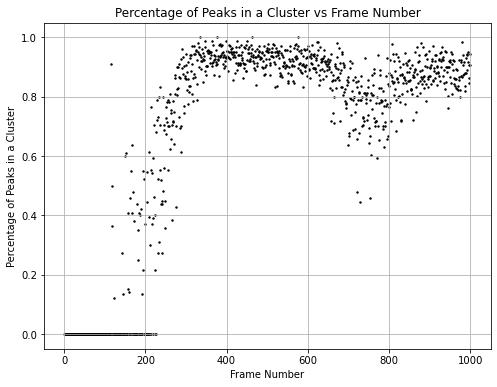

array([[1.00000000e+00, 4.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [2.00000000e+00, 2.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [3.00000000e+00, 4.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       ...,
       [9.98000000e+02, 5.90000000e+01, 5.10000000e+01, 8.64406780e-01],
       [9.99000000e+02, 5.40000000e+01, 5.10000000e+01, 9.44444444e-01],
       [1.00000000e+03, 5.40000000e+01, 4.90000000e+01, 9.07407407e-01]])

In [26]:
clusters_ = np.loadtxt(str(OutputFile)+'_cluster_results.txt', skiprows = 1)
peaks_ = np.loadtxt(str(OutputFile)+'_good_peaks.txt')

turbulence.stats_clusters(InputFile, clusters = clusters_, peaks = peaks_)

# Correlator Routine
By running this step, a text file containing correlator results will be generated and stored under 'correlaotr_frames/correlator+Filename' subdirectory.

Plotted correlator frames along with a movie based on your choice of d_limit = X will be generated and stored under 'correlaotr_frames/correlator_frames_dlimX'.

You can run multiple d_limits using a for loop but it will take a very long time if you choose to plot the results at the same time.

In [27]:
os.chdir(DefaultDir) 
importlib.reload(turbulence)

CorrelatorInput = OutputFile+'_cluster_results.txt'
# DoPlot = False ###### Choose whether to plot and save each frame. Ture yes False no.
DoPlot = True

# Correlator of full duration 8 - 26s
TimeMin = 8
TimeMax = TimeStampArray[-1,0]*1e-6 # Last frame time 25.968s 
# Correlator from heater on
# TimeMin = 12 # heater turned on at 12s
# TimeMax = 17 #

# for d_limit in range(1,41):
d_limit = 10
turbulence.correlator(InputFile, CorrelatorInput, TimeStampArray, TimeMin, TimeMax, d_limit, DoPlot, frame_format = 'jpg')

Created Directory :  /Users/mf3/Dropbox (ORNL)/Project Turbulent Flow/Our Papers/SecondPaper/DataRepository/example_for_mike_to_test//correlator_frames
Created Directory :  /Users/mf3/Dropbox (ORNL)/Project Turbulent Flow/Our Papers/SecondPaper/DataRepository/example_for_mike_to_test//correlator_frames/correlator_Script113_19_45_16_967
Created Directory :  /Users/mf3/Dropbox (ORNL)/Project Turbulent Flow/Our Papers/SecondPaper/DataRepository/example_for_mike_to_test//correlator_frames/correlator_frames_dlim10
A frame does not have clusters.
Frame 1 has 0 clusters
Frame 2 has 0 clusters
Did not find pairs within 10 pixels for frames 1 and 2
A frame does not have clusters.
Frame 2 has 0 clusters
Frame 3 has 0 clusters
Did not find pairs within 10 pixels for frames 2 and 3
A frame does not have clusters.
Frame 3 has 0 clusters
Frame 4 has 0 clusters
Did not find pairs within 10 pixels for frames 3 and 4
A frame does not have clusters.
Frame 4 has 0 clusters
Frame 5 has 0 clusters
Did not 

A frame does not have clusters.
Frame 58 has 0 clusters
Frame 59 has 0 clusters
Did not find pairs within 10 pixels for frames 58 and 59
A frame does not have clusters.
Frame 59 has 0 clusters
Frame 60 has 0 clusters
Did not find pairs within 10 pixels for frames 59 and 60
A frame does not have clusters.
Frame 60 has 0 clusters
Frame 61 has 0 clusters
Did not find pairs within 10 pixels for frames 60 and 61
A frame does not have clusters.
Frame 61 has 0 clusters
Frame 62 has 0 clusters
Did not find pairs within 10 pixels for frames 61 and 62
A frame does not have clusters.
Frame 62 has 0 clusters
Frame 63 has 0 clusters
Did not find pairs within 10 pixels for frames 62 and 63
A frame does not have clusters.
Frame 63 has 0 clusters
Frame 64 has 0 clusters
Did not find pairs within 10 pixels for frames 63 and 64
A frame does not have clusters.
Frame 64 has 0 clusters
Frame 65 has 0 clusters
Did not find pairs within 10 pixels for frames 64 and 65
A frame does not have clusters.
Frame 65 

A frame does not have clusters.
Frame 119 has 0 clusters
Frame 120 has 0 clusters
Did not find pairs within 10 pixels for frames 119 and 120
A frame does not have clusters.
Frame 120 has 0 clusters
Frame 121 has 0 clusters
Did not find pairs within 10 pixels for frames 120 and 121
A frame does not have clusters.
Frame 121 has 0 clusters
Frame 122 has 0 clusters
Did not find pairs within 10 pixels for frames 121 and 122
A frame does not have clusters.
Frame 122 has 0 clusters
Frame 123 has 1 clusters
Did not find pairs within 10 pixels for frames 122 and 123
A frame does not have clusters.
Frame 123 has 1 clusters
Frame 124 has 0 clusters
Did not find pairs within 10 pixels for frames 123 and 124
A frame does not have clusters.
Frame 124 has 0 clusters
Frame 125 has 0 clusters
Did not find pairs within 10 pixels for frames 124 and 125
A frame does not have clusters.
Frame 125 has 0 clusters
Frame 126 has 0 clusters
Did not find pairs within 10 pixels for frames 125 and 126
A frame does 

A frame does not have clusters.
Frame 181 has 2 clusters
Frame 182 has 0 clusters
Did not find pairs within 10 pixels for frames 181 and 182
A frame does not have clusters.
Frame 182 has 0 clusters
Frame 183 has 0 clusters
Did not find pairs within 10 pixels for frames 182 and 183
A frame does not have clusters.
Frame 183 has 0 clusters
Frame 184 has 2 clusters
Did not find pairs within 10 pixels for frames 183 and 184
A frame does not have clusters.
Frame 184 has 2 clusters
Frame 185 has 0 clusters
Did not find pairs within 10 pixels for frames 184 and 185
A frame does not have clusters.
Frame 185 has 0 clusters
Frame 186 has 0 clusters
Did not find pairs within 10 pixels for frames 185 and 186
A frame does not have clusters.
Frame 186 has 0 clusters
Frame 187 has 3 clusters
Did not find pairs within 10 pixels for frames 186 and 187
A frame does not have clusters.
Frame 187 has 3 clusters
Frame 188 has 0 clusters
Did not find pairs within 10 pixels for frames 187 and 188
A frame does 

284 285 13.10 13.12 0 -3
285 286 13.12 13.13 1 9
286 287 13.13 13.15 9 1
Did not find pairs within 10 pixels for frames 287 and 288
288 289 13.17 13.19 -8 2
Did not find pairs within 10 pixels for frames 289 and 290
290 291 13.21 13.22 1 -7
291 292 13.22 13.24 -3 -1
Did not find pairs within 10 pixels for frames 292 and 293
293 294 13.26 13.28 1 6
Did not find pairs within 10 pixels for frames 294 and 295
295 296 13.30 13.31 10 -7
Did not find pairs within 10 pixels for frames 296 and 297
Did not find pairs within 10 pixels for frames 297 and 298
Did not find pairs within 10 pixels for frames 298 and 299
299 300 13.37 13.39 0 -2
Did not find pairs within 10 pixels for frames 300 and 301
Did not find pairs within 10 pixels for frames 301 and 302
302 303 13.42 13.44 -1 -7
303 304 13.44 13.46 6 6
304 305 13.46 13.48 4 4
305 306 13.48 13.49 4 5
306 307 13.49 13.51 0 4
307 308 13.51 13.53 14 7
308 309 13.53 13.55 0 -9
309 310 13.55 13.57 -2 8
310 311 13.57 13.58 2 -7
311 312 13.58 13.60 3 5

504 505 17.06 17.08 -1 8
505 506 17.08 17.09 17 -2
Did not find pairs within 10 pixels for frames 506 and 507
507 508 17.11 17.13 -2 -6
508 509 17.13 17.15 0 0
509 510 17.15 17.17 3 -5
510 511 17.17 17.18 3 7
511 512 17.18 17.20 0 -12
Did not find pairs within 10 pixels for frames 512 and 513
513 514 17.22 17.24 -8 4
514 515 17.24 17.26 10 0
515 516 17.26 17.27 -7 6
516 517 17.27 17.29 -5 2
Did not find pairs within 10 pixels for frames 517 and 518
518 519 17.31 17.33 0 0
519 520 17.33 17.35 1 -4
520 521 17.35 17.36 2 6
521 522 17.36 17.38 -1 -2
522 523 17.38 17.40 14 0
523 524 17.40 17.42 4 7
524 525 17.42 17.44 5 -8
525 526 17.44 17.45 0 -1
Did not find pairs within 10 pixels for frames 526 and 527
527 528 17.47 17.49 4 7
528 529 17.49 17.51 -1 1
529 530 17.51 17.53 7 0
Did not find pairs within 10 pixels for frames 530 and 531
531 532 17.54 17.56 -5 0
532 533 17.56 17.58 5 -10
533 534 17.58 17.60 7 4
534 535 17.60 17.62 4 0
535 536 17.62 17.63 1 -1
536 537 17.63 17.65 4 7
Did not fi

Did not find pairs within 10 pixels for frames 716 and 717
Did not find pairs within 10 pixels for frames 717 and 718
Did not find pairs within 10 pixels for frames 718 and 719
Did not find pairs within 10 pixels for frames 719 and 720
720 721 20.95 20.96 11 -1
Did not find pairs within 10 pixels for frames 721 and 722
722 723 20.98 21.00 -6 4
Did not find pairs within 10 pixels for frames 723 and 724
724 725 21.02 21.04 -6 6
Did not find pairs within 10 pixels for frames 725 and 726
726 727 21.05 21.07 -1 8
727 728 21.07 21.09 -5 -2
728 729 21.09 21.11 0 5
Did not find pairs within 10 pixels for frames 729 and 730
730 731 21.13 21.14 -1 -3
Did not find pairs within 10 pixels for frames 731 and 732
732 733 21.16 21.18 1 -2
Did not find pairs within 10 pixels for frames 733 and 734
734 735 21.20 21.22 6 -5
Did not find pairs within 10 pixels for frames 735 and 736
Did not find pairs within 10 pixels for frames 736 and 737
Did not find pairs within 10 pixels for frames 737 and 738
738 73

923 924 24.60 24.62 -13 -3
Did not find pairs within 10 pixels for frames 924 and 925
925 926 24.64 24.65 3 6
Did not find pairs within 10 pixels for frames 926 and 927
Did not find pairs within 10 pixels for frames 927 and 928
Did not find pairs within 10 pixels for frames 928 and 929
Did not find pairs within 10 pixels for frames 929 and 930
930 931 24.73 24.74 6 -3
931 932 24.74 24.76 -4 1
932 933 24.76 24.78 -8 3
933 934 24.78 24.80 -4 -1
934 935 24.80 24.82 2 -5
935 936 24.82 24.83 6 3
936 937 24.83 24.85 0 3
937 938 24.85 24.87 2 1
938 939 24.87 24.89 -2 6
Did not find pairs within 10 pixels for frames 939 and 940
Did not find pairs within 10 pixels for frames 940 and 941
Did not find pairs within 10 pixels for frames 941 and 942
942 943 24.94 24.96 -5 5
943 944 24.96 24.98 -3 0
944 945 24.98 25.00 6 -1
Did not find pairs within 10 pixels for frames 945 and 946
946 947 25.01 25.03 0 -7
Did not find pairs within 10 pixels for frames 947 and 948
948 949 25.05 25.07 8 -4
949 950 25.

In [28]:
# Clear memory
import gc
gc.collect()

3099243